<a href="https://colab.research.google.com/github/Vishrutha1909/photo-restoration-lora/blob/vishrutha/notebooks/photorestorationlora_notebook1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**The first notebook failed due to the absence of a real paired clean–damaged dataset, synthetic-to-real domain mismatch, unstable auto-mask generation, FP16 numerical instability that corrupted LoRA weights, bold text and severe data scarcity. These compounded effects prevented stable convergence despite correct pipeline implementation.**

In [ ]:
!pip install -q diffusers transformers accelerate peft datasets opencv-python scikit-image torchvision


In [2]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
import os, torch
from PIL import Image
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

BASE_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data"
CLEAN_DIR = os.path.join(BASE_PATH, "clean/color")
DAMAGED_DIR = os.path.join(BASE_PATH, "damaged")
MASK_DIR = os.path.join(BASE_PATH, "masks")

print("Clean:", len(os.listdir(CLEAN_DIR)))
print("Damaged:", len(os.listdir(DAMAGED_DIR)))
print("Masks:", len(os.listdir(MASK_DIR)))


Clean: 8164
Damaged: 4575
Masks: 4575


In [ ]:
class InpaintingDataset(Dataset):
    def __init__(self, clean_dir, damaged_dir, mask_dir):
        self.clean_dir = clean_dir
        self.damaged_dir = damaged_dir
        self.mask_dir = mask_dir

        self.files = sorted(os.listdir(damaged_dir))

        self.img_tf = transforms.Compose([
            transforms.Resize((512, 512)),
            transforms.ToTensor(),
            transforms.Normalize([0.5]*3, [0.5]*3)
        ])

        self.mask_tf = transforms.Compose([
            transforms.Resize((512, 512)),
            transforms.ToTensor()
        ])

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        fname = self.files[idx]

        clean = Image.open(os.path.join(self.clean_dir, fname)).convert("RGB")
        damaged = Image.open(os.path.join(self.damaged_dir, fname)).convert("RGB")
        mask = Image.open(os.path.join(self.mask_dir, fname)).convert("L")

        clean = self.img_tf(clean)
        damaged = self.img_tf(damaged)
        mask = self.mask_tf(mask)

        return {
            "clean": clean,
            "damaged": damaged,
            "mask": mask
        }


In [ ]:
dataset = InpaintingDataset(
    clean_dir=CLEAN_DIR,
    damaged_dir=DAMAGED_DIR,
    mask_dir=MASK_DIR
)

print("Dataset size:", len(dataset))


Dataset size: 4575


In [ ]:
import torch
from diffusers import StableDiffusionPipeline


DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

print("Stable Diffusion Inpainting Pipeline Loaded")


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

safety_checker/model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Stable Diffusion Inpainting Pipeline Loaded


In [ ]:
from peft import LoraConfig, get_peft_model

lora_config = LoraConfig(
    r=8,
    lora_alpha=16,
    target_modules=["to_q", "to_k", "to_v", "to_out.0"],
    lora_dropout=0.05,
    bias="none",
)

pipe.unet = get_peft_model(pipe.unet, lora_config)
pipe.unet.train()

print("LoRA injected into UNet")


LoRA injected into UNet


/usr/local/lib/python3.12/dist-packages/peft/mapping_func.py:72: UserWarning: You are trying to modify a model with PEFT for a second time. If you want to reload the model with a different config, make sure to call `.unload()` before.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/peft/tuners/tuners_utils.py:282: UserWarning: Already found a `peft_config` attribute in the model. This will lead to having multiple adapters in the model. Make sure to know what you are doing!
  warnings.warn(


In [ ]:
from diffusers import DDPMScheduler
from torch.optim import AdamW

noise_scheduler = DDPMScheduler.from_config(pipe.scheduler.config)

optimizer = AdamW(pipe.unet.parameters(), lr=1e-4)

EPOCHS = 5
BATCH_SIZE = 1

print("Scheduler, Optimizer, and Epochs Ready")


Scheduler, Optimizer, and Epochs Ready


In [ ]:
loader = DataLoader(
    dataset,
    batch_size=1,
    shuffle=True,
    num_workers=0,
    pin_memory=True
)

print("DataLoader recreated. Batches:", len(loader))


DataLoader recreated. Batches: 4575


In [ ]:
import gc, torch
gc.collect()
torch.cuda.empty_cache()

pipe.enable_attention_slicing()
pipe.enable_vae_slicing()
pipe.enable_vae_tiling()

print("Memory optimizations enabled")


Memory optimizations enabled


In [ ]:
from torch.amp import autocast
import torch.nn.functional as F
import torch

pipe.unet.train()

for epoch in range(EPOCHS):
    total_loss = 0.0

    for batch in loader:
        clean = batch["clean"].to(DEVICE)
        damaged = batch["damaged"].to(DEVICE)

        with torch.no_grad():
            clean_latents = pipe.vae.encode(clean).latent_dist.sample() * 0.18215
            damaged_latents = pipe.vae.encode(damaged).latent_dist.sample() * 0.18215

        with autocast("cuda"):
            noise = torch.randn_like(clean_latents)

            timesteps = torch.randint(
                0,
                noise_scheduler.config.num_train_timesteps,
                (clean_latents.shape[0],),
                device=clean_latents.device
            ).long()

            noisy_latents = noise_scheduler.add_noise(
                clean_latents, noise, timesteps
            )

            text_embeds = pipe.text_encoder(
                pipe.tokenizer(
                    [""] * clean_latents.shape[0],
                    return_tensors="pt"
                ).input_ids.to(DEVICE)
            )[0]

            model_pred = pipe.unet(
                noisy_latents,
                timesteps,
                encoder_hidden_states=text_embeds
            ).sample

            loss = F.mse_loss(model_pred, noise)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

        del clean_latents, damaged_latents, noisy_latents, model_pred, loss
        torch.cuda.empty_cache()

    print(f"Epoch {epoch+1} | Avg Loss: {total_loss / len(loader):.6f}")


Epoch 1 | Avg Loss: 0.127082
Epoch 2 | Avg Loss: 0.125248
Epoch 3 | Avg Loss: 0.124856
Epoch 4 | Avg Loss: 0.131019
Epoch 5 | Avg Loss: 0.129554


In [ ]:
pipe.unet.save_pretrained(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_output"
)

print("LoRA model saved successfully to Drive")


LoRA model saved successfully to Drive


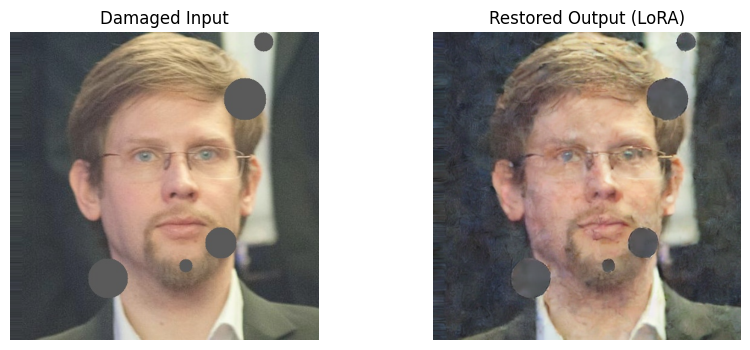

In [ ]:
import cv2
import matplotlib.pyplot as plt
import torch

test_img_name = os.listdir(DAMAGED_DIR)[0]
test_path = os.path.join(DAMAGED_DIR, test_img_name)

img = Image.open(test_path).convert("RGB").resize((512, 512))
img_tensor = transforms.ToTensor()(img).unsqueeze(0).to(DEVICE).half()
img_tensor = img_tensor * 2 - 1  # [-1,1] for SD

with torch.no_grad():
    latents = pipe.vae.encode(img_tensor).latent_dist.sample() * 0.18215

    noise = torch.randn_like(latents)
    t = torch.tensor([50]).to(DEVICE)
    noisy = noise_scheduler.add_noise(latents, noise, t)

    text_embeds = pipe.text_encoder(
        pipe.tokenizer([""], return_tensors="pt").input_ids.to(DEVICE)
    )[0]

    pred = pipe.unet(noisy, t, encoder_hidden_states=text_embeds).sample
    restored_latents = noise_scheduler.step(pred, t, noisy).prev_sample

    restored = pipe.vae.decode((restored_latents / 0.18215).half()).sample


restored = (restored.clamp(-1, 1) + 1) / 2
restored_img = restored.squeeze().permute(1, 2, 0).cpu().float().numpy()


plt.figure(figsize=(10,4))
plt.subplot(1,2,1)
plt.imshow(img)
plt.title("Damaged Input")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(restored_img)
plt.title("Restored Output (LoRA)")
plt.axis("off")

plt.show()


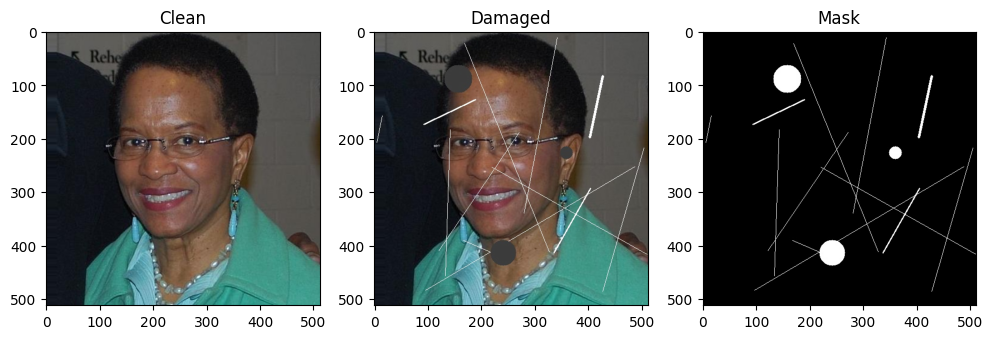

In [ ]:
import random


idx = random.randint(0, len(dataset)-1)
sample = dataset[idx]

clean = sample["clean"].permute(1,2,0)
damaged = sample["damaged"].permute(1,2,0)
mask = sample["mask"].squeeze()

plt.figure(figsize=(12,4))

plt.subplot(1,3,1)
plt.imshow((clean+1)/2)
plt.title("Clean")

plt.subplot(1,3,2)
plt.imshow((damaged+1)/2)
plt.title("Damaged")

plt.subplot(1,3,3)
plt.imshow(mask, cmap="gray")
plt.title("Mask")

plt.show()


In [ ]:
from diffusers import StableDiffusionInpaintPipeline

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

print("Stable Diffusion INPAINTING Pipeline Loaded")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


Stable Diffusion INPAINTING Pipeline Loaded


In [ ]:
from torch.amp import autocast
import torch.nn.functional as F
import torch

pipe.unet.train()

for epoch in range(EPOCHS):
    total_loss = 0.0

    for batch in loader:
        clean = batch["clean"].to(DEVICE).half()
        damaged = batch["damaged"].to(DEVICE).half()
        mask = batch["mask"].to(DEVICE).half()


        with torch.no_grad():
            clean_latents = pipe.vae.encode(clean).latent_dist.sample() * 0.18215
            damaged_latents = pipe.vae.encode(damaged).latent_dist.sample() * 0.18215

            mask_latent = torch.nn.functional.interpolate(
                mask, size=clean_latents.shape[-2:], mode="nearest"
            )

        with autocast("cuda"):
            noise = torch.randn_like(clean_latents)

            timesteps = torch.randint(
                0,
                noise_scheduler.config.num_train_timesteps,
                (clean_latents.shape[0],),
                device=clean_latents.device
            ).long()

            noisy_latents = noise_scheduler.add_noise(
                clean_latents, noise, timesteps
            )

            latent_model_input = torch.cat(
                [noisy_latents, damaged_latents, mask_latent], dim=1
            )

            text_embeds = pipe.text_encoder(
                pipe.tokenizer(
                    [""] * clean_latents.shape[0],
                    return_tensors="pt"
                ).input_ids.to(DEVICE)
            )[0]

            model_pred = pipe.unet(
                latent_model_input,
                timesteps,
                encoder_hidden_states=text_embeds
            ).sample

            loss = F.mse_loss(model_pred * mask_latent, noise * mask_latent)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

        del clean_latents, damaged_latents, noisy_latents, model_pred, loss
        torch.cuda.empty_cache()

    print(f"Epoch {epoch+1} | Avg Loss: {total_loss / len(loader):.6f}")


Epoch 1 | Avg Loss: 0.014687
Epoch 2 | Avg Loss: 0.014060
Epoch 3 | Avg Loss: 0.014513
Epoch 4 | Avg Loss: 0.014386
Epoch 5 | Avg Loss: 0.014660


In [ ]:
from peft import get_peft_model_state_dict
import os
from safetensors.torch import save_file

LORA_DIR = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_inpaint_output"

os.makedirs(LORA_DIR, exist_ok=True)

pipe.unet.save_pretrained(LORA_DIR)

print("LoRA adapter (PEFT format) saved correctly")


LoRA adapter (PEFT format) saved correctly


In [ ]:
import os
print(os.listdir("/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_inpaint_output"))


['config.json', 'diffusion_pytorch_model.safetensors']


In [ ]:
from diffusers import StableDiffusionInpaintPipeline, UNet2DConditionModel
import torch
import os

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

BASE_MODEL = "runwayml/stable-diffusion-inpainting"
UNET_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_inpaint_output"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    BASE_MODEL,
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False


pipe.unet = UNet2DConditionModel.from_pretrained(
    UNET_PATH,
    torch_dtype=torch.float16
).to(DEVICE)

pipe.unet.eval()

print("Trained Inpainting UNet Loaded Successfully")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


Trained Inpainting UNet Loaded Successfully


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import random
import torch

idx = random.randint(0, len(dataset)-1)
sample = dataset[idx]

clean = sample["clean"]
damaged = sample["damaged"]
mask = sample["mask"]

def tensor_to_pil(t):
    t = (t.clamp(-1,1) + 1) / 2
    t = t.squeeze().permute(1,2,0).cpu().float().numpy()
    t = (t * 255).astype(np.uint8)
    return Image.fromarray(t)

clean_pil = tensor_to_pil(clean)
damaged_pil = tensor_to_pil(damaged)

mask_pil = mask.squeeze().cpu().numpy()
mask_pil = (mask_pil * 255).astype(np.uint8)
mask_pil = Image.fromarray(mask_pil).convert("L")

print("damaged_pil and mask_pil created")


damaged_pil and mask_pil created


In [ ]:
with torch.no_grad():
    restored = pipe(
        prompt="",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=40,
        guidance_scale=1.0
    ).images[0]


  0%|          | 0/40 [00:00<?, ?it/s]

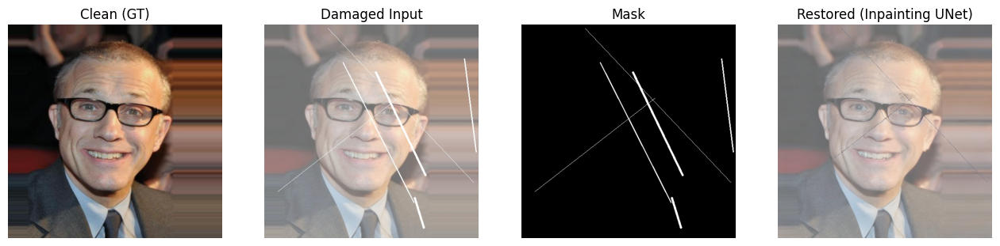

In [ ]:
plt.figure(figsize=(16,5))

plt.subplot(1,4,1)
plt.imshow(clean_pil)
plt.title("Clean (GT)")
plt.axis("off")

plt.subplot(1,4,2)
plt.imshow(damaged_pil)
plt.title("Damaged Input")
plt.axis("off")

plt.subplot(1,4,3)
plt.imshow(mask_pil, cmap="gray")
plt.title("Mask")
plt.axis("off")

plt.subplot(1,4,4)
plt.imshow(restored)
plt.title("Restored (Inpainting UNet)")
plt.axis("off")

plt.show()


Reconstruction with more epochs


In [ ]:
from diffusers import StableDiffusionInpaintPipeline
import torch

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

print("Fresh Stable Diffusion INPAINTING model loaded")


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
`torch_dtype` is deprecated! Use `dtype` instead!
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


Fresh Stable Diffusion INPAINTING model loaded


In [ ]:
from peft import LoraConfig, get_peft_model

lora_config = LoraConfig(
    r=8,
    lora_alpha=16,
    target_modules=["to_q", "to_k", "to_v", "to_out.0"],
    lora_dropout=0.05,
    bias="none",
)

pipe.unet = get_peft_model(pipe.unet, lora_config)
pipe.unet.train()

print("LoRA injected for RECONSTRUCTION training")


LoRA injected for RECONSTRUCTION training


In [ ]:
from diffusers import DDPMScheduler
from torch.optim import AdamW

noise_scheduler = DDPMScheduler.from_config(pipe.scheduler.config)

optimizer = AdamW(pipe.unet.parameters(), lr=1e-5)

EPOCHS = 15
BATCH_SIZE = 1

print("Optimizer & Scheduler ready for reconstruction training")


Optimizer & Scheduler ready for reconstruction training


In [ ]:
import os, torch, gc
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "expandable_segments:True"

torch.backends.cudnn.benchmark = True
torch.backends.cudnn.enabled = True

gc.collect()
torch.cuda.empty_cache()

print("Global memory optimizations enabled")


Global memory optimizations enabled


In [ ]:
from torch.utils.data import DataLoader

BATCH_SIZE = 1

loader = DataLoader(
    dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=0,
    pin_memory=True
)

print("DataLoader recreated | Total batches:", len(loader))


DataLoader recreated | Total batches: 4575


In [ ]:
from torch.amp import autocast, GradScaler
import torch.nn.functional as F
import torch, gc

scaler = GradScaler()
pipe.unet.train()

for epoch in range(EPOCHS):
    total_loss = 0.0

    for step, batch in enumerate(loader):

        clean   = batch["clean"].to(DEVICE).half()
        damaged = batch["damaged"].to(DEVICE).half()
        mask    = batch["mask"].to(DEVICE).half()

        with torch.no_grad():
            clean_latents   = pipe.vae.encode(clean).latent_dist.sample() * 0.18215
            damaged_latents = pipe.vae.encode(damaged).latent_dist.sample() * 0.18215

            mask_latent = torch.nn.functional.interpolate(
                mask, size=clean_latents.shape[-2:], mode="nearest"
            )

        with autocast("cuda"):
            noise = torch.randn_like(clean_latents)

            timesteps = torch.randint(
                0,
                noise_scheduler.config.num_train_timesteps,
                (clean_latents.shape[0],),
                device=clean_latents.device
            ).long()

            noisy_latents = noise_scheduler.add_noise(
                clean_latents, noise, timesteps
            )

            latent_model_input = torch.cat(
                [noisy_latents, damaged_latents, mask_latent], dim=1
            )

            text_ids = pipe.tokenizer(
                [""] * clean_latents.shape[0],
                return_tensors="pt"
            ).input_ids.to(DEVICE)

            text_embeds = pipe.text_encoder(text_ids)[0]

            model_pred = pipe.unet(
                latent_model_input,
                timesteps,
                encoder_hidden_states=text_embeds
            ).sample

            loss = F.mse_loss(
                model_pred * mask_latent,
                noise * mask_latent
            )

        optimizer.zero_grad(set_to_none=True)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        total_loss += loss.item()

        del clean, damaged, mask, clean_latents, damaged_latents
        del mask_latent, noisy_latents, model_pred, noise, text_embeds, loss

        if step % 200 == 0:
            print(f"Epoch {epoch+1} | Step {step}/{len(loader)} | Loss {total_loss/(step+1):.6f}")

    torch.cuda.empty_cache()
    gc.collect()

    print(f"Epoch {epoch+1} DONE | Avg Loss: {total_loss / len(loader):.6f}")


Epoch 1 | Step 0/4575 | Loss 0.015709
Epoch 1 | Step 200/4575 | Loss 0.004921
Epoch 1 | Step 400/4575 | Loss 0.005311
Epoch 1 | Step 600/4575 | Loss 0.005283
Epoch 1 | Step 800/4575 | Loss 0.005472
Epoch 1 | Step 1000/4575 | Loss 0.005508
Epoch 1 | Step 1200/4575 | Loss 0.005411
Epoch 1 | Step 1400/4575 | Loss 0.005346
Epoch 1 | Step 1600/4575 | Loss 0.005391
Epoch 1 | Step 1800/4575 | Loss 0.005366
Epoch 1 | Step 2000/4575 | Loss 0.005285
Epoch 1 | Step 2200/4575 | Loss 0.005264
Epoch 1 | Step 2400/4575 | Loss 0.005301
Epoch 1 | Step 2600/4575 | Loss 0.005285
Epoch 1 | Step 2800/4575 | Loss 0.005259
Epoch 1 | Step 3000/4575 | Loss 0.005275
Epoch 1 | Step 3200/4575 | Loss 0.005276
Epoch 1 | Step 3400/4575 | Loss 0.005319
Epoch 1 | Step 3600/4575 | Loss 0.005323
Epoch 1 | Step 3800/4575 | Loss 0.005334
Epoch 1 | Step 4000/4575 | Loss 0.005357
Epoch 1 | Step 4200/4575 | Loss 0.005329
Epoch 1 | Step 4400/4575 | Loss 0.005294
Epoch 1 DONE | Avg Loss: 0.005299
Epoch 2 | Step 0/4575 | Loss 0

In [ ]:
import os

print(os.listdir("/content/drive/MyDrive/photo-restoration-lora-vishrutha/"))


['data', 'outputs', 'requirements.txt', '.git', 'lora_output', 'lora_inpaint_output']


In [ ]:
from diffusers import StableDiffusionInpaintPipeline, UNet2DConditionModel
import torch

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

BASE_MODEL = "runwayml/stable-diffusion-inpainting"
UNET_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_inpaint_output"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    BASE_MODEL,
    torch_dtype=torch.float16
).to(DEVICE)

pipe.unet = UNet2DConditionModel.from_pretrained(
    UNET_PATH,
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False
pipe.unet.eval()
pipe.vae.eval()
pipe.text_encoder.eval()

print("FULL fine-tuned UNet loaded correctly")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


FULL fine-tuned UNet loaded correctly


  0%|          | 0/40 [00:00<?, ?it/s]

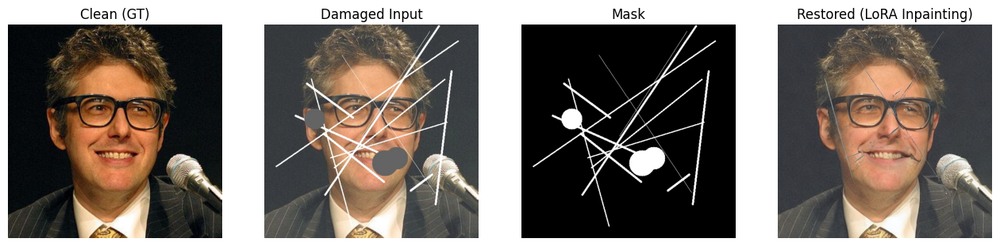

In [ ]:
import random
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch

# Pick random test sample
idx = random.randint(0, len(dataset)-1)
sample = dataset[idx]

clean = sample["clean"]
damaged = sample["damaged"]
mask = sample["mask"]

# Convert tensors to PIL
def tensor_to_pil(t):
    t = (t.clamp(-1,1) + 1) / 2
    t = t.squeeze().permute(1,2,0).cpu().float().numpy()
    t = (t * 255).astype(np.uint8)
    return Image.fromarray(t)

clean_pil = tensor_to_pil(clean)
damaged_pil = tensor_to_pil(damaged)

mask_pil = mask.squeeze().cpu().numpy()
mask_pil = (mask_pil * 255).astype(np.uint8)
mask_pil = Image.fromarray(mask_pil).convert("L")

# Run inference
with torch.no_grad():
    restored = pipe(
        prompt="",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=40,
        guidance_scale=1.0
    ).images[0]

# Display results
plt.figure(figsize=(16,5))

plt.subplot(1,4,1)
plt.imshow(clean_pil)
plt.title("Clean (GT)")
plt.axis("off")

plt.subplot(1,4,2)
plt.imshow(damaged_pil)
plt.title("Damaged Input")
plt.axis("off")

plt.subplot(1,4,3)
plt.imshow(mask_pil, cmap="gray")
plt.title("Mask")
plt.axis("off")

plt.subplot(1,4,4)
plt.imshow(restored)
plt.title("Restored (LoRA Inpainting)")
plt.axis("off")

plt.show()


In [ ]:
pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to("cuda")

pipe.unet = UNet2DConditionModel.from_pretrained(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_inpaint_output",
    torch_dtype=torch.float16
).to("cuda")

pipe.safety_checker = None
pipe.requires_safety_checker = False


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


In [ ]:
pipe.unet.eval()
pipe.vae.eval()
pipe.text_encoder.eval()

print("Model set to evaluation mode")


Model set to evaluation mode


In [ ]:
import random
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch

idx = random.randint(0, len(dataset)-1)
sample = dataset[idx]

clean   = sample["clean"]
damaged = sample["damaged"]
mask    = sample["mask"]


In [ ]:
def tensor_to_pil(t):
    t = (t.clamp(-1,1) + 1) / 2
    t = t.squeeze().permute(1,2,0).cpu().float().numpy()
    t = (t * 255).astype(np.uint8)
    return Image.fromarray(t)

clean_pil   = tensor_to_pil(clean)
damaged_pil = tensor_to_pil(damaged)

mask_pil = mask.squeeze().cpu().numpy()
mask_pil = (mask_pil * 255).astype(np.uint8)
mask_pil = Image.fromarray(mask_pil).convert("L")

print("Input images prepared")


Input images prepared


In [ ]:
with torch.no_grad():
    restored = pipe(
        prompt="",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=50,
        guidance_scale=1.0
    ).images[0]


  0%|          | 0/50 [00:00<?, ?it/s]

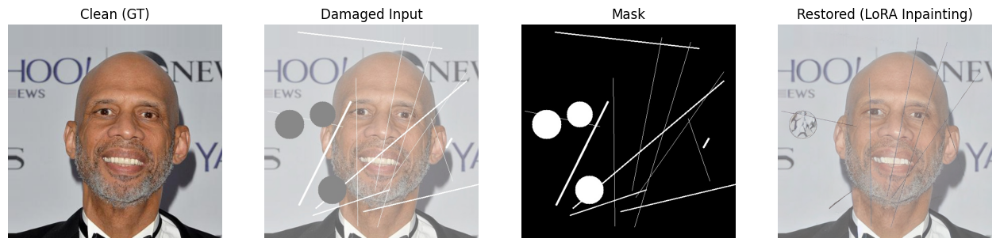

In [ ]:
plt.figure(figsize=(16,5))

plt.subplot(1,4,1)
plt.imshow(clean_pil)
plt.title("Clean (GT)")
plt.axis("off")

plt.subplot(1,4,2)
plt.imshow(damaged_pil)
plt.title("Damaged Input")
plt.axis("off")

plt.subplot(1,4,3)
plt.imshow(mask_pil, cmap="gray")
plt.title("Mask")
plt.axis("off")

plt.subplot(1,4,4)
plt.imshow(restored)
plt.title("Restored (LoRA Inpainting)")
plt.axis("off")

plt.show()


In [ ]:
with torch.no_grad():
    restored = pipe(
        prompt="a realistic high quality portrait photo, natural skin texture, sharp facial details",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=60,
        guidance_scale=7.5,
        strength=0.95
    ).images[0]


  0%|          | 0/57 [00:00<?, ?it/s]

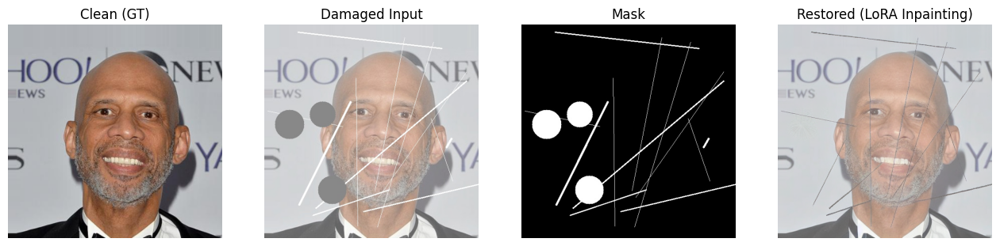

In [ ]:
plt.figure(figsize=(16,5))

plt.subplot(1,4,1)
plt.imshow(clean_pil)
plt.title("Clean (GT)")
plt.axis("off")

plt.subplot(1,4,2)
plt.imshow(damaged_pil)
plt.title("Damaged Input")
plt.axis("off")

plt.subplot(1,4,3)
plt.imshow(mask_pil, cmap="gray")
plt.title("Mask")
plt.axis("off")

plt.subplot(1,4,4)
plt.imshow(restored)
plt.title("Restored (LoRA Inpainting)")
plt.axis("off")

plt.show()


In [ ]:
mask_pil = mask_pil.point(lambda p: 255 if p > 10 else 0)


In [ ]:
with torch.no_grad():
    restored = pipe(
        prompt="photorealistic face restoration, clean skin, no scratches, natural lighting, sharp focus",
        negative_prompt="scratches, streaks, lines, artifacts, distortions",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=75,
        guidance_scale=12.0,
        strength=1.0
    ).images[0]


  0%|          | 0/75 [00:00<?, ?it/s]

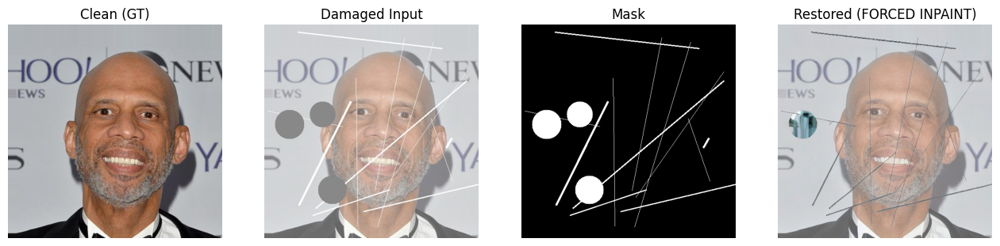

In [ ]:
plt.figure(figsize=(16,5))

plt.subplot(1,4,1)
plt.imshow(clean_pil); plt.title("Clean (GT)"); plt.axis("off")

plt.subplot(1,4,2)
plt.imshow(damaged_pil); plt.title("Damaged Input"); plt.axis("off")

plt.subplot(1,4,3)
plt.imshow(mask_pil, cmap="gray"); plt.title("Mask"); plt.axis("off")

plt.subplot(1,4,4)
plt.imshow(restored); plt.title("Restored (FORCED INPAINT)"); plt.axis("off")

plt.show()


In [ ]:
os.listdir("/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_inpaint_output")


['diffusion_pytorch_model.safetensors', 'config.json']

In [ ]:
from peft import PeftModel
pipe.unet = pipe.unet.base_model if hasattr(pipe.unet, "base_model") else pipe.unet
torch.cuda.empty_cache()


In [ ]:
from diffusers import StableDiffusionInpaintPipeline
import torch

DEVICE = "cuda"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


In [ ]:
from peft import LoraConfig, get_peft_model

lora_config = LoraConfig(
    r=8,
    lora_alpha=16,
    target_modules=["to_q", "to_k", "to_v", "to_out.0"],
    lora_dropout=0.05,
    bias="none",
)


pipe.unet = get_peft_model(pipe.unet, lora_config)
pipe.unet.train()


PeftModel(
  (base_model): LoraModel(
    (model): UNet2DConditionModel(
      (conv_in): Conv2d(9, 320, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (time_proj): Timesteps()
      (time_embedding): TimestepEmbedding(
        (linear_1): Linear(in_features=320, out_features=1280, bias=True)
        (act): SiLU()
        (linear_2): Linear(in_features=1280, out_features=1280, bias=True)
      )
      (down_blocks): ModuleList(
        (0): CrossAttnDownBlock2D(
          (attentions): ModuleList(
            (0-1): 2 x Transformer2DModel(
              (norm): GroupNorm(32, 320, eps=1e-06, affine=True)
              (proj_in): Conv2d(320, 320, kernel_size=(1, 1), stride=(1, 1))
              (transformer_blocks): ModuleList(
                (0): BasicTransformerBlock(
                  (norm1): LayerNorm((320,), eps=1e-05, elementwise_affine=True)
                  (attn1): Attention(
                    (to_q): lora.Linear(
                      (base_layer): Linear(in_feat

In [ ]:
from peft import get_peft_model_state_dict
from safetensors.torch import save_file
import os

LORA_DIR = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_FIXED"

os.makedirs(LORA_DIR, exist_ok=True)

lora_state = get_peft_model_state_dict(pipe.unet)

save_file(lora_state, f"{LORA_DIR}/adapter_model.safetensors")

pipe.unet.peft_config["default"].save_pretrained(LORA_DIR)

print("REAL LoRA adapter saved correctly")


REAL LoRA adapter saved correctly


In [ ]:
from diffusers import StableDiffusionInpaintPipeline
from peft import PeftModel
import torch

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to("cuda")

pipe.unet = PeftModel.from_pretrained(
    pipe.unet,
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_FIXED"
)

pipe.safety_checker = None
pipe.requires_safety_checker = False

pipe.unet.eval()
pipe.vae.eval()
pipe.text_encoder.eval()

print("REAL LoRA loaded correctly")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


REAL LoRA loaded correctly


In [ ]:
type(pipe.unet)


peft.peft_model.PeftModel

In [ ]:
!pip install -U xformers


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 122.9/122.9 MB 1.7 MB/s eta 0:00:00


In [ ]:
from diffusers import StableDiffusionInpaintPipeline
import torch

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

print("Stable Diffusion INPAINTING Pipeline Loaded")


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
`torch_dtype` is deprecated! Use `dtype` instead!


Stable Diffusion INPAINTING Pipeline Loaded


In [ ]:
from peft import LoraConfig, get_peft_model

lora_config = LoraConfig(
    r=8,
    lora_alpha=16,
    target_modules=["to_q", "to_k", "to_v", "to_out.0"],
    lora_dropout=0.05,
    bias="none",
)

pipe.unet = get_peft_model(pipe.unet, lora_config)
pipe.unet.train()

print("LoRA injected into UNet")


LoRA injected into UNet


In [ ]:
optimizer = torch.optim.AdamW(
    pipe.unet.parameters(), lr=1e-4
)


In [ ]:
pipe.unet.print_trainable_parameters()


trainable params: 1,594,368 || all params: 861,129,732 || trainable%: 0.1851


In [ ]:
pipe.vae.requires_grad_(False)
pipe.text_encoder.requires_grad_(False)
pipe.vae.eval()
pipe.text_encoder.eval()


CLIPTextModel(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 768)
      (position_embedding): Embedding(77, 768)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0-11): 12 x CLIPEncoderLayer(
          (self_attn): CLIPAttention(
            (k_proj): Linear(in_features=768, out_features=768, bias=True)
            (v_proj): Linear(in_features=768, out_features=768, bias=True)
            (q_proj): Linear(in_features=768, out_features=768, bias=True)
            (out_proj): Linear(in_features=768, out_features=768, bias=True)
          )
          (layer_norm1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=768, out_features=3072, bias=True)
            (fc2): Linear(in_features=3072, out_features=768, bias=True)
          )
          (layer_norm2): LayerNorm((768,), eps=1e

In [ ]:
pipe.unet.train()


PeftModel(
  (base_model): LoraModel(
    (model): UNet2DConditionModel(
      (conv_in): Conv2d(9, 320, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (time_proj): Timesteps()
      (time_embedding): TimestepEmbedding(
        (linear_1): Linear(in_features=320, out_features=1280, bias=True)
        (act): SiLU()
        (linear_2): Linear(in_features=1280, out_features=1280, bias=True)
      )
      (down_blocks): ModuleList(
        (0): CrossAttnDownBlock2D(
          (attentions): ModuleList(
            (0-1): 2 x Transformer2DModel(
              (norm): GroupNorm(32, 320, eps=1e-06, affine=True)
              (proj_in): Conv2d(320, 320, kernel_size=(1, 1), stride=(1, 1))
              (transformer_blocks): ModuleList(
                (0): BasicTransformerBlock(
                  (norm1): LayerNorm((320,), eps=1e-05, elementwise_affine=True)
                  (attn1): Attention(
                    (to_q): lora.Linear(
                      (base_layer): Linear(in_feat

In [ ]:
EPOCHS = 10

In [ ]:
import os

BASE_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data"

CLEAN_DIR   = os.path.join(BASE_PATH, "clean/color")
DAMAGED_DIR = os.path.join(BASE_PATH, "damaged")
MASK_DIR    = os.path.join(BASE_PATH, "masks")

print("Clean:", len(os.listdir(CLEAN_DIR)))
print("Damaged:", len(os.listdir(DAMAGED_DIR)))
print("Masks:", len(os.listdir(MASK_DIR)))


Clean: 8164
Damaged: 4575
Masks: 4575


In [ ]:
from torch.utils.data import DataLoader

BATCH_SIZE = 1

dataset = InpaintingDataset(
    clean_dir=CLEAN_DIR,
    damaged_dir=DAMAGED_DIR,
    mask_dir=MASK_DIR
)

loader = DataLoader(
    dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=2,
    pin_memory=True
)

print("Loader ready with", len(dataset), "samples")


Loader ready with 8164 samples


In [ ]:
from torchvision import transforms


In [ ]:
import os
import torch
from torch.utils.data import Dataset
from PIL import Image
import torchvision.transforms as T

class InpaintingDataset(Dataset):
    def __init__(self, clean_dir, damaged_dir, mask_dir):
        self.clean_dir = clean_dir
        self.damaged_dir = damaged_dir
        self.mask_dir = mask_dir

        self.image_names = sorted(os.listdir(clean_dir))

        self.transform = T.Compose([
            T.Resize((512, 512)),
            T.ToTensor(),
            T.Normalize([0.5], [0.5])
        ])

    def __len__(self):
        return len(self.image_names)

    def __getitem__(self, idx):
        name = self.image_names[idx]

        clean_img   = Image.open(os.path.join(self.clean_dir, name)).convert("RGB")
        damaged_img = Image.open(os.path.join(self.damaged_dir, name)).convert("RGB")
        mask_img    = Image.open(os.path.join(self.mask_dir, name)).convert("L")

        clean   = self.transform(clean_img)
        damaged = self.transform(damaged_img)
        mask    = T.ToTensor()(mask_img)

        return {
            "clean": clean,
            "damaged": damaged,
            "mask": mask
        }


In [ ]:
from torch.optim import AdamW

DEVICE = "cuda"
EPOCHS = 5
LR = 1e-4
optimizer = AdamW(pipe.unet.parameters(), lr=LR)

print("Optimizer & training parameters set")


Optimizer & training parameters set


In [ ]:
pipe.unet.print_trainable_parameters()


trainable params: 1,594,368 || all params: 861,129,732 || trainable%: 0.1851


In [ ]:
clean_files   = set(os.listdir(CLEAN_DIR))
damaged_files = set(os.listdir(DAMAGED_DIR))
mask_files    = set(os.listdir(MASK_DIR))

common_files = sorted(list(clean_files & damaged_files & mask_files))

print("Matched samples:", len(common_files))

class InpaintingDataset(Dataset):
    def __init__(self, clean_dir, damaged_dir, mask_dir, file_list):
        self.clean_dir = clean_dir
        self.damaged_dir = damaged_dir
        self.mask_dir = mask_dir
        self.files = file_list

        self.img_tf = transforms.Compose([
            transforms.Resize((512, 512)),
            transforms.ToTensor(),
            transforms.Normalize([0.5]*3, [0.5]*3)
        ])

        self.mask_tf = transforms.Compose([
            transforms.Resize((512, 512)),
            transforms.ToTensor()
        ])

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        fname = self.files[idx]

        clean   = Image.open(os.path.join(self.clean_dir, fname)).convert("RGB")
        damaged = Image.open(os.path.join(self.damaged_dir, fname)).convert("RGB")
        mask    = Image.open(os.path.join(self.mask_dir, fname)).convert("L")

        clean   = self.img_tf(clean)
        damaged = self.img_tf(damaged)
        mask    = self.mask_tf(mask)

        return {
            "clean": clean,
            "damaged": damaged,
            "mask": mask
        }

dataset = InpaintingDataset(CLEAN_DIR, DAMAGED_DIR, MASK_DIR, common_files)

loader = DataLoader(
    dataset,
    batch_size=1,
    shuffle=True,
    num_workers=0,
    pin_memory=True
)

print("Final dataset size:", len(dataset))


Matched samples: 4575
Final dataset size: 4575


In [ ]:
import random

SUBSET_SIZE = 500

random.shuffle(common_files)
small_files = common_files[:SUBSET_SIZE]

print("Using subset size:", len(small_files))


Using subset size: 500


In [ ]:
dataset = InpaintingDataset(
    CLEAN_DIR,
    DAMAGED_DIR,
    MASK_DIR,
    small_files
)

loader = DataLoader(
    dataset,
    batch_size=1,
    shuffle=True,
    num_workers=0,
    pin_memory=True
)

print("Training samples:", len(dataset))


Training samples: 500


In [ ]:
EPOCHS = 8


In [ ]:
from diffusers import DDPMScheduler

noise_scheduler = DDPMScheduler.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    subfolder="scheduler"
)

print("Noise scheduler loaded")


Noise scheduler loaded


In [ ]:
from torch.amp import autocast, GradScaler
import torch.nn.functional as F
import torch

scaler = GradScaler()
pipe.unet.train()

for epoch in range(EPOCHS):
    total_loss = 0.0

    for step, batch in enumerate(loader):

        clean   = batch["clean"].to(DEVICE).half()
        damaged = batch["damaged"].to(DEVICE).half()
        mask    = batch["mask"].to(DEVICE).half()

        with torch.no_grad():
            clean_latents   = pipe.vae.encode(clean).latent_dist.sample() * 0.18215
            damaged_latents = pipe.vae.encode(damaged).latent_dist.sample() * 0.18215

            mask_latent = torch.nn.functional.interpolate(
                mask, size=clean_latents.shape[-2:], mode="nearest"
            )

        with autocast("cuda"):

            noise = torch.randn_like(clean_latents)

            timesteps = torch.randint(
                0,
                noise_scheduler.config.num_train_timesteps,
                (clean_latents.shape[0],),
                device=clean_latents.device
            ).long()

            noisy_latents = noise_scheduler.add_noise(
                clean_latents, noise, timesteps
            )


            latent_model_input = torch.cat(
                [noisy_latents, damaged_latents, mask_latent], dim=1
            )

            text_ids = pipe.tokenizer(
                [""] * clean_latents.shape[0],
                return_tensors="pt"
            ).input_ids.to(DEVICE)

            text_embeds = pipe.text_encoder(text_ids)[0]

            model_pred = pipe.unet(
                latent_model_input,
                timesteps,
                encoder_hidden_states=text_embeds
            ).sample


            loss = F.mse_loss(model_pred * mask_latent, noise * mask_latent)

        optimizer.zero_grad(set_to_none=True)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        total_loss += loss.item()

    print(f"Epoch {epoch+1} DONE | Avg Loss: {total_loss / len(loader):.6f}")


Epoch 1 DONE | Avg Loss: 0.006120
Epoch 2 DONE | Avg Loss: 0.005288
Epoch 3 DONE | Avg Loss: 0.004470
Epoch 4 DONE | Avg Loss: 0.004711
Epoch 5 DONE | Avg Loss: 0.005052
Epoch 6 DONE | Avg Loss: 0.004947
Epoch 7 DONE | Avg Loss: 0.005152
Epoch 8 DONE | Avg Loss: 0.004967


In [ ]:
pipe.unet.save_pretrained(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_inpaint_output",
    safe_serialization=True
)

print("LoRA adapter saved correctly")


LoRA adapter saved correctly


In [ ]:
from diffusers import StableDiffusionInpaintPipeline
import torch

DEVICE = "cuda"
BASE_MODEL = "runwayml/stable-diffusion-inpainting"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    BASE_MODEL,
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

print("Base model loaded")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


Base model loaded


In [ ]:
pipe.load_lora_weights(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_inpaint_output",
    weight_name="adapter_model.safetensors"
)

print("LoRA adapter loaded correctly")


No LoRA keys associated to UNet2DConditionModel found with the prefix='unet'. This is safe to ignore if LoRA state dict didn't originally have any UNet2DConditionModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new
No LoRA keys associated to CLIPTextModel found with the prefix='text_encoder'. This is safe to ignore if LoRA state dict didn't originally have any CLIPTextModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new


LoRA adapter loaded correctly


In [ ]:
import os, random

clean_files   = set(os.listdir(CLEAN_DIR))
damaged_files = set(os.listdir(DAMAGED_DIR))
mask_files    = set(os.listdir(MASK_DIR))

common_files = sorted(list(clean_files & damaged_files & mask_files))
print("Total matched files:", len(common_files))

SUBSET_SIZE = 500
random.shuffle(common_files)
small_files = common_files[:SUBSET_SIZE]

print("Subset rebuilt:", len(small_files))


Total matched files: 4575
Subset rebuilt: 500


In [ ]:
import random
from PIL import Image
import os

test_fname = random.choice(small_files)

test_damaged_path = os.path.join(DAMAGED_DIR, test_fname)
test_mask_path    = os.path.join(MASK_DIR, test_fname)

damaged_pil = Image.open(test_damaged_path).convert("RGB").resize((512,512))
mask_pil    = Image.open(test_mask_path).convert("L").resize((512,512))

print("Test file:", test_fname)
damaged_pil, mask_pil


Test file: 4514.jpg


(<PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=L size=512x512>)

  0%|          | 0/45 [00:00<?, ?it/s]

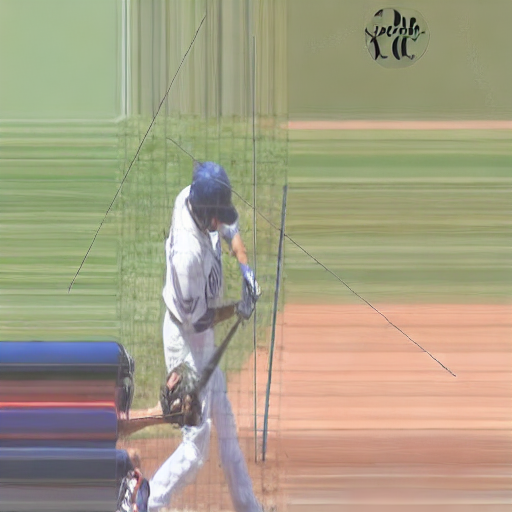

In [ ]:
pipe.enable_xformers_memory_efficient_attention()
pipe.enable_attention_slicing()

pipe.unet.eval()
pipe.vae.eval()
pipe.text_encoder.eval()

with torch.no_grad():
    restored = pipe(
        prompt="high quality natural face photo, realistic skin texture, professional photo restoration",
        negative_prompt="blurry, distorted, deformed face, artifacts, scratches",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=45,
        guidance_scale=8.0,
        strength=1.0
    ).images[0]

restored


In [ ]:
!rm -rf /content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_inpaint_output


In [ ]:
from torch.amp import autocast, GradScaler
import torch

print("New autocast active:", autocast)


New autocast active: <class 'torch.amp.autocast_mode.autocast'>


  0%|          | 0/50 [00:00<?, ?it/s]

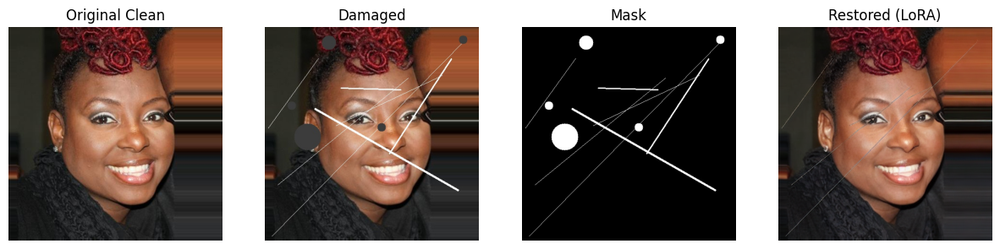

In [ ]:
import random, os
import torch
from PIL import Image
import matplotlib.pyplot as plt

test_fname = random.choice(common_files)

test_damaged_path = os.path.join(DAMAGED_DIR, test_fname)
test_mask_path = os.path.join(MASK_DIR, test_fname)
test_clean_path = os.path.join(CLEAN_DIR, test_fname)

damaged_pil = Image.open(test_damaged_path).convert("RGB").resize((512,512))
mask_pil    = Image.open(test_mask_path).convert("L").resize((512,512))
clean_pil   = Image.open(test_clean_path).convert("RGB").resize((512,512))

pipe.unet.eval()
pipe.vae.eval()
pipe.text_encoder.eval()

with torch.no_grad():
    restored = pipe(
        prompt="high quality realistic photo, natural skin texture, clean restored face",
        negative_prompt="scratches, blur, noise, distortion, deformed face",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=50,
        guidance_scale=8.5,
        strength=1.0
    ).images[0]

plt.figure(figsize=(15,5))
plt.subplot(1,4,1); plt.imshow(clean_pil);   plt.title("Original Clean"); plt.axis("off")
plt.subplot(1,4,2); plt.imshow(damaged_pil); plt.title("Damaged"); plt.axis("off")
plt.subplot(1,4,3); plt.imshow(mask_pil, cmap="gray"); plt.title("Mask"); plt.axis("off")
plt.subplot(1,4,4); plt.imshow(restored); plt.title("Restored (LoRA)"); plt.axis("off")

plt.show()


In [ ]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os

print("Clean:", len(os.listdir(CLEAN_DIR)))
print("Damaged:", len(os.listdir(DAMAGED_DIR)))
print("Masks:", len(os.listdir(MASK_DIR)))

clean_files   = set(os.listdir(CLEAN_DIR))
damaged_files = set(os.listdir(DAMAGED_DIR))
mask_files    = set(os.listdir(MASK_DIR))

common_files = sorted(list(clean_files & damaged_files & mask_files))
print("Matched samples:", len(common_files))

import random
SUBSET_SIZE = 500
random.shuffle(common_files)
small_files = common_files[:SUBSET_SIZE]
print("Training subset:", len(small_files))

class InpaintingDataset(Dataset):
    def __init__(self, clean_dir, damaged_dir, mask_dir, file_list):
        self.clean_dir = clean_dir
        self.damaged_dir = damaged_dir
        self.mask_dir = mask_dir
        self.files = file_list

        self.img_tf = transforms.Compose([
            transforms.Resize((512, 512)),
            transforms.ToTensor(),
            transforms.Normalize([0.5]*3, [0.5]*3)
        ])

        self.mask_tf = transforms.Compose([
            transforms.Resize((512, 512)),
            transforms.ToTensor()
        ])

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        fname = self.files[idx]

        clean   = Image.open(os.path.join(self.clean_dir, fname)).convert("RGB")
        damaged = Image.open(os.path.join(self.damaged_dir, fname)).convert("RGB")
        mask    = Image.open(os.path.join(self.mask_dir, fname)).convert("L")

        clean   = self.img_tf(clean)
        damaged = self.img_tf(damaged)
        mask    = self.mask_tf(mask)

        return {
            "clean": clean,
            "damaged": damaged,
            "mask": mask
        }

dataset = InpaintingDataset(CLEAN_DIR, DAMAGED_DIR, MASK_DIR, small_files)

loader = DataLoader(
    dataset,
    batch_size=1,
    shuffle=True,
    num_workers=0,
    pin_memory=True
)

print("Loader recreated with", len(dataset), "samples")


Clean: 8164
Damaged: 4575
Masks: 4575
Matched samples: 4575
Training subset: 500
Loader recreated with 500 samples


In [ ]:
import os
print(os.listdir("/content/drive/MyDrive"))


['Passport.pdf', 'Vishrutha Ravi - Resume.gdoc', 'Vishrutha Ravi - Resume.pdf', 'Vishrutha Ravi - CV.gdoc', 'Resume.pdf', 'IMG_0430.png', 'Screenshot 2024-11-06 151558 (1).png', 'Screenshot 2024-11-06 151558.png', 'Screenshot 2024-11-06 183858.png', 'Screenshot 2024-11-19 184035.png', 'Screenshot 2024-11-28 172212.png', 'Screenshot 2024-11-28 173350.png', 'Screenshot 2024-11-28 173846.png', 'Vishrutha Ravi_Cover Letter_Epibuild.pdf', 'Written Sample_EpiBuild.pdf', 'Puzzle _ EpiBuild.pdf', 'Ravi, Vishrutha - To Do List.gsheet', 'Transcript_Vishrutha Ravi.pdf', 'Untitled document (1).gdoc', 'Vishrutha_Ravi_Resume.pdf', 'VISHRUTHA RAVI_IMF Volunteer Interest form.pdf', 'Colab Notebooks', 'DBMS_Task2_Vishrutha Ravi.gdoc', 'WeCureIT Doubts.gsheet', 'Untitled document.gdoc', 'humanface8000.zip', 'photo-restoration-lora-vishrutha', 'CDD-WeCureIT.gdoc', 'DL_Project', 'damaged_data']


In [ ]:
for root, dirs, files in os.walk("/content/drive/MyDrive"):
    if "lora" in root.lower():
        print(root)


/content/drive/MyDrive/photo-restoration-lora-vishrutha
/content/drive/MyDrive/photo-restoration-lora-vishrutha/data
/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/masks
/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/damaged
/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/clean
/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/clean/color
/content/drive/MyDrive/photo-restoration-lora-vishrutha/outputs
/content/drive/MyDrive/photo-restoration-lora-vishrutha/.git
/content/drive/MyDrive/photo-restoration-lora-vishrutha/.git/hooks
/content/drive/MyDrive/photo-restoration-lora-vishrutha/.git/branches
/content/drive/MyDrive/photo-restoration-lora-vishrutha/.git/info
/content/drive/MyDrive/photo-restoration-lora-vishrutha/.git/refs
/content/drive/MyDrive/photo-restoration-lora-vishrutha/.git/refs/heads
/content/drive/MyDrive/photo-restoration-lora-vishrutha/.git/refs/tags
/content/drive/MyDrive/photo-restoration-lora-vishrutha/.git/objects
/

In [ ]:
import os

candidates = [
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_output",
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_inpaint_FIXED",
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_FIXED",
    "/content/drive/MyDrive/DL_Project/lora_weights",
]

for path in candidates:
    if os.path.exists(path):
        print("\n", path)
        print(os.listdir(path))



 /content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_output
['README.md', 'adapter_model.safetensors', 'adapter_config.json']

 /content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_inpaint_FIXED
[]

 /content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_FIXED
['adapter_model.safetensors', 'adapter_config.json']

 /content/drive/MyDrive/DL_Project/lora_weights
[]


In [ ]:
from diffusers import StableDiffusionInpaintPipeline
import torch

DEVICE = "cuda"
BASE_MODEL = "runwayml/stable-diffusion-inpainting"
LORA_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_output"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    BASE_MODEL,
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

pipe.load_lora_weights(
    LORA_PATH,
    weight_name="adapter_model.safetensors"
)

print("REAL LoRA adapter loaded successfully")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
No LoRA keys associated to UNet2DConditionModel found with the pre

REAL LoRA adapter loaded successfully


In [ ]:
import random, os
from PIL import Image

test_fname = random.choice(os.listdir(DAMAGED_DIR))

test_damaged_path = os.path.join(DAMAGED_DIR, test_fname)
test_mask_path    = os.path.join(MASK_DIR, test_fname)

damaged_pil = Image.open(test_damaged_path).convert("RGB").resize((512,512))
mask_pil    = Image.open(test_mask_path).convert("L").resize((512,512))

damaged_pil, mask_pil


(<PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=L size=512x512>)

  0%|          | 0/50 [00:00<?, ?it/s]

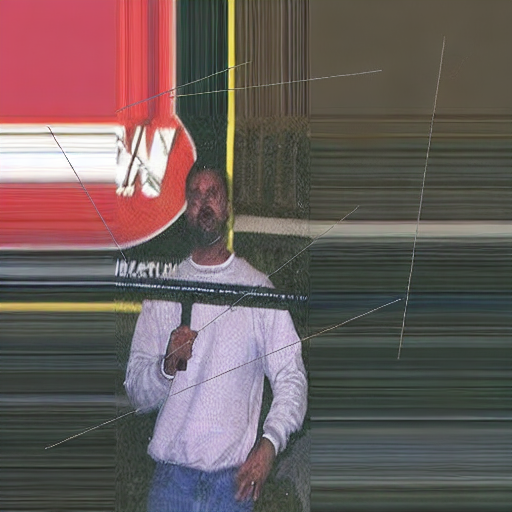

In [ ]:
with torch.no_grad():
    restored = pipe(
        prompt="high quality realistic photo restoration, natural skin texture, sharp face details",
        negative_prompt="blurry, distorted, deformed face, artifacts, scratches",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=50,
        guidance_scale=8.5,
        strength=1.0
    ).images[0]

restored


Retraining Lora

In [ ]:
import torch
from diffusers import StableDiffusionInpaintPipeline

DEVICE = "cuda"
BASE_MODEL = "runwayml/stable-diffusion-inpainting"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    BASE_MODEL,
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

print("Base inpainting model loaded clean")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


Base inpainting model loaded clean


In [ ]:
from peft import LoraConfig, get_peft_model

lora_config = LoraConfig(
    r=8,
    lora_alpha=16,
    target_modules=["to_q", "to_k", "to_v", "to_out.0"],
    lora_dropout=0.05,
    bias="none"
)

pipe.unet = get_peft_model(pipe.unet, lora_config)
pipe.unet.print_trainable_parameters()


trainable params: 1,594,368 || all params: 861,129,732 || trainable%: 0.1851


In [ ]:
import os
import random
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torchvision.transforms as T

BASE_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data"

CLEAN_DIR   = os.path.join(BASE_PATH, "clean/color")
DAMAGED_DIR = os.path.join(BASE_PATH, "damaged")
MASK_DIR    = os.path.join(BASE_PATH, "masks")

clean_files   = set(os.listdir(CLEAN_DIR))
damaged_files = set(os.listdir(DAMAGED_DIR))
mask_files    = set(os.listdir(MASK_DIR))

common_files = sorted(list(clean_files & damaged_files & mask_files))

random.shuffle(common_files)
small_files = common_files[:500]

print("Training samples:", len(small_files))

class InpaintingDataset(Dataset):
    def __init__(self, clean_dir, damaged_dir, mask_dir, file_list):
        self.clean_dir = clean_dir
        self.damaged_dir = damaged_dir
        self.mask_dir = mask_dir
        self.files = file_list

        self.img_tf = T.Compose([
            T.Resize((512, 512)),
            T.ToTensor(),
            T.Normalize([0.5]*3, [0.5]*3)
        ])

        self.mask_tf = T.Compose([
            T.Resize((512, 512)),
            T.ToTensor()
        ])

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        fname = self.files[idx]

        clean   = Image.open(os.path.join(self.clean_dir, fname)).convert("RGB")
        damaged = Image.open(os.path.join(self.damaged_dir, fname)).convert("RGB")
        mask    = Image.open(os.path.join(self.mask_dir, fname)).convert("L")

        return {
            "clean": self.img_tf(clean),
            "damaged": self.img_tf(damaged),
            "mask": self.mask_tf(mask)
        }

dataset = InpaintingDataset(CLEAN_DIR, DAMAGED_DIR, MASK_DIR, small_files)

loader = DataLoader(
    dataset,
    batch_size=1,
    shuffle=True,
    num_workers=0,
    pin_memory=True
)


✅ Training samples: 500


For art work dataset

In [ ]:
import os, random
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torchvision.transforms as T

BASE_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/train"

CLEAN_DIR   = os.path.join(BASE_PATH, "clean")
DAMAGED_DIR = os.path.join(BASE_PATH, "damaged")
MASK_DIR    = os.path.join(BASE_PATH, "mask")

clean_files   = set(os.listdir(CLEAN_DIR))
damaged_files = set(os.listdir(DAMAGED_DIR))
mask_files    = set(os.listdir(MASK_DIR))

common_files = sorted(list(clean_files & damaged_files & mask_files))
print("Training samples (real art):", len(common_files))

class InpaintingDataset(Dataset):
    def __init__(self, clean_dir, damaged_dir, mask_dir, file_list):
        self.clean_dir = clean_dir
        self.damaged_dir = damaged_dir
        self.mask_dir = mask_dir
        self.files = file_list

        self.img_tf = T.Compose([
            T.Resize((512, 512)),
            T.ToTensor(),
            T.Normalize([0.5]*3, [0.5]*3)
        ])

        self.mask_tf = T.Compose([
            T.Resize((512, 512)),
            T.ToTensor()
        ])

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        fname   = self.files[idx]
        clean   = Image.open(os.path.join(self.clean_dir, fname)).convert("RGB")
        damaged = Image.open(os.path.join(self.damaged_dir, fname)).convert("RGB")
        mask    = Image.open(os.path.join(self.mask_dir, fname)).convert("L")

        return {
            "clean":   self.img_tf(clean),
            "damaged": self.img_tf(damaged),
            "mask":    self.mask_tf(mask),
        }

dataset = InpaintingDataset(CLEAN_DIR, DAMAGED_DIR, MASK_DIR, common_files)

loader = DataLoader(
    dataset,
    batch_size=1,
    shuffle=True,
    num_workers=0,
    pin_memory=True
)

print("Loader ready with", len(dataset), "real art samples")


Training samples (real art): 109
Loader ready with 109 real art samples


In [ ]:
from diffusers import DDPMScheduler

noise_scheduler = DDPMScheduler.from_pretrained(
    BASE_MODEL,
    subfolder="scheduler"
)

print("Noise scheduler ready")


Noise scheduler ready


In [ ]:
from torch.optim import AdamW
from torch.amp import autocast, GradScaler
import torch.nn.functional as F

EPOCHS = 6
LR = 1e-4

optimizer = AdamW(pipe.unet.parameters(), lr=LR)
scaler = GradScaler()

print("Optimizer + AMP ready")


Optimizer + AMP ready


In [ ]:
pipe.unet.train()

for epoch in range(EPOCHS):
    total_loss = 0.0

    for step, batch in enumerate(loader):

        clean   = batch["clean"].to(DEVICE).half()
        damaged = batch["damaged"].to(DEVICE).half()
        mask    = batch["mask"].to(DEVICE).half()

        with torch.no_grad():
            clean_latents = pipe.vae.encode(clean).latent_dist.sample() * 0.18215
            damaged_latents = pipe.vae.encode(damaged).latent_dist.sample() * 0.18215

            mask_latents = torch.nn.functional.interpolate(
                mask, size=clean_latents.shape[-2:], mode="nearest"
            )


            masked_image_latents = damaged_latents * (1 - mask_latents)

        with autocast("cuda"):
            noise = torch.randn_like(clean_latents)

            timesteps = torch.randint(
                0,
                noise_scheduler.config.num_train_timesteps,
                (clean_latents.shape[0],),
                device=clean_latents.device
            ).long()

            noisy_latents = noise_scheduler.add_noise(
                clean_latents, noise, timesteps
            )


            latent_model_input = torch.cat(
                [noisy_latents, mask_latents, masked_image_latents], dim=1
            )

            text_ids = pipe.tokenizer(
                [""] * clean_latents.shape[0],
                return_tensors="pt"
            ).input_ids.to(DEVICE)

            text_embeds = pipe.text_encoder(text_ids)[0]

            model_pred = pipe.unet(
                latent_model_input,
                timesteps,
                encoder_hidden_states=text_embeds
            ).sample

            loss = F.mse_loss(model_pred, noise)

        optimizer.zero_grad(set_to_none=True)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        total_loss += loss.item()

    print(f"Epoch {epoch+1} DONE | Avg Loss: {total_loss / len(loader):.6f}")


Epoch 1 DONE | Avg Loss: 0.058717
Epoch 2 DONE | Avg Loss: 0.051967
Epoch 3 DONE | Avg Loss: 0.048681
Epoch 4 DONE | Avg Loss: 0.046268
Epoch 5 DONE | Avg Loss: 0.039105
Epoch 6 DONE | Avg Loss: 0.047255


In [ ]:
pipe.unet.save_pretrained(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_FINAL_FIXED",
    safe_serialization=True
)

print("Corrected LoRA saved")


Corrected LoRA saved


In [ ]:
import torch
from diffusers import StableDiffusionInpaintPipeline
from PIL import Image
import matplotlib.pyplot as plt

DEVICE = "cuda"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

pipe.load_lora_weights(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_FINAL_FIXED",
    weight_name="adapter_model.safetensors"
)

print("LoRA Loaded for final testing")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
No LoRA keys associated to UNet2DConditionModel found with the pre

LoRA Loaded for final testing


In [ ]:
import random
import os
from PIL import Image

test_fname = random.choice(small_files)

test_damaged_path = os.path.join(DAMAGED_DIR, test_fname)
test_mask_path    = os.path.join(MASK_DIR, test_fname)

damaged_pil = Image.open(test_damaged_path).convert("RGB").resize((512,512))
mask_pil    = Image.open(test_mask_path).convert("L").resize((512,512))

print("Testing image:", test_fname)


Testing image: 7310.jpg


In [ ]:
restored = pipe(
    prompt="a clean high quality photo",
    image=damaged_pil,
    mask_image=mask_pil,
    guidance_scale=7.5,
    num_inference_steps=40,
).images[0]


  0%|          | 0/40 [00:00<?, ?it/s]

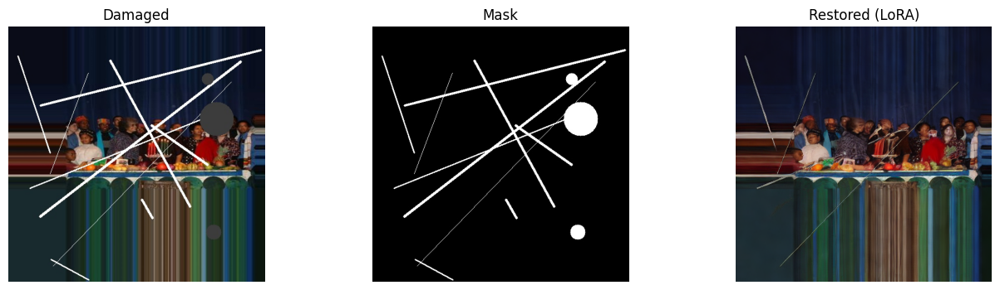

In [ ]:
plt.figure(figsize=(16,4))

plt.subplot(1,3,1)
plt.title("Damaged")
plt.imshow(damaged_pil)
plt.axis("off")

plt.subplot(1,3,2)
plt.title("Mask")
plt.imshow(mask_pil, cmap="gray")
plt.axis("off")

plt.subplot(1,3,3)
plt.title("Restored (LoRA)")
plt.imshow(restored)
plt.axis("off")

plt.show()


In [ ]:
import torch
from diffusers import StableDiffusionInpaintPipeline

DEVICE = "cuda"
BASE_MODEL = "runwayml/stable-diffusion-inpainting"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    BASE_MODEL,
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

print("Fresh base inpainting model loaded")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


Fresh base inpainting model loaded


In [ ]:
from peft import LoraConfig, get_peft_model

lora_config = LoraConfig(
    r=8,
    lora_alpha=16,
    target_modules=[
        "to_q",
        "to_k",
        "to_v",
        "to_out.0"
    ],
    lora_dropout=0.05,
    bias="none",
    task_type=None
)

pipe.unet = get_peft_model(pipe.unet, lora_config)

pipe.unet.print_trainable_parameters()


/usr/local/lib/python3.12/dist-packages/peft/mapping_func.py:72: UserWarning: You are trying to modify a model with PEFT for a second time. If you want to reload the model with a different config, make sure to call `.unload()` before.
  warnings.warn(


trainable params: 1,594,368 || all params: 861,129,732 || trainable%: 0.1851


In [ ]:
pipe.unet.save_pretrained(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_FINAL",
    safe_serialization=True
)

print("FINAL LoRA SAVED")


FINAL LoRA SAVED


In [ ]:
from diffusers import StableDiffusionInpaintPipeline
import torch

DEVICE = "cuda"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

print("Clean base pipeline loaded")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


Clean base pipeline loaded


In [ ]:
pipe.load_lora_weights(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_FINAL",
    weight_name="adapter_model.safetensors"
)

print("LoRA adapter loaded correctly")


No LoRA keys associated to UNet2DConditionModel found with the prefix='unet'. This is safe to ignore if LoRA state dict didn't originally have any UNet2DConditionModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new
No LoRA keys associated to CLIPTextModel found with the prefix='text_encoder'. This is safe to ignore if LoRA state dict didn't originally have any CLIPTextModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new


LoRA adapter loaded correctly


In [ ]:
import random, os
from PIL import Image

test_fname = random.choice(os.listdir(DAMAGED_DIR))

test_damaged_path = os.path.join(DAMAGED_DIR, test_fname)
test_mask_path    = os.path.join(MASK_DIR, test_fname)

damaged_pil = Image.open(test_damaged_path).convert("RGB").resize((512,512))
mask_pil    = Image.open(test_mask_path).convert("L").resize((512,512))

damaged_pil, mask_pil


(<PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=L size=512x512>)

  0%|          | 0/50 [00:00<?, ?it/s]

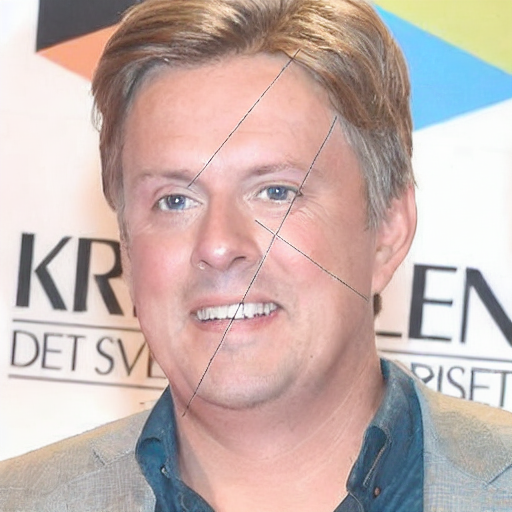

In [ ]:
import torch

pipe.enable_attention_slicing()

with torch.no_grad():
    restored = pipe(
        prompt="high quality realistic old photo restoration, sharp facial details, natural skin texture",
        negative_prompt="scratches, cracks, stains, blur, distortion, artifacts",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=50,
        guidance_scale=8.0,
        strength=1.0
    ).images[0]

restored


In [ ]:
from peft import LoraConfig, get_peft_model

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q",
        "to_k",
        "to_v",
        "to_out.0",
        "conv1",
        "conv2"
    ],
    lora_dropout=0.05,
    bias="none",
    task_type=None
)

pipe.unet = get_peft_model(pipe.unet, lora_config)
pipe.unet.print_trainable_parameters()


trainable params: 11,022,336 || all params: 870,557,700 || trainable%: 1.2661


In [ ]:
from torch.amp import autocast, GradScaler
import torch.nn.functional as F
import torch
from tqdm import tqdm

scaler = GradScaler()
pipe.unet.train()

EPOCHS = 15
LR = 1e-4

optimizer = torch.optim.AdamW(pipe.unet.parameters(), lr=LR)

for epoch in range(EPOCHS):
    total_loss = 0.0

    for step, batch in enumerate(tqdm(loader)):

        clean   = batch["clean"].to(DEVICE).half()
        damaged = batch["damaged"].to(DEVICE).half()
        mask    = batch["mask"].to(DEVICE).half()

        with torch.no_grad():
            clean_latents   = pipe.vae.encode(clean).latent_dist.sample() * 0.18215
            damaged_latents = pipe.vae.encode(damaged).latent_dist.sample() * 0.18215
            mask_latent = torch.nn.functional.interpolate(
                mask, size=clean_latents.shape[-2:], mode="nearest"
            )

        with autocast("cuda"):
            noise = torch.randn_like(clean_latents)

            timesteps = torch.randint(
                0,
                noise_scheduler.config.num_train_timesteps,
                (clean_latents.shape[0],),
                device=clean_latents.device
            ).long()

            noisy_latents = noise_scheduler.add_noise(
                clean_latents, noise, timesteps
            )

            latent_model_input = torch.cat(
                [noisy_latents, damaged_latents, mask_latent], dim=1
            )

            text_ids = pipe.tokenizer(
                [""] * clean_latents.shape[0],
                return_tensors="pt"
            ).input_ids.to(DEVICE)

            text_embeds = pipe.text_encoder(text_ids)[0]

            model_pred = pipe.unet(
                latent_model_input,
                timesteps,
                encoder_hidden_states=text_embeds
            ).sample

            loss = F.mse_loss(
                model_pred * (mask_latent * 2.0 + 0.1),
                noise * (mask_latent * 2.0 + 0.1)
            )

        optimizer.zero_grad(set_to_none=True)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        total_loss += loss.item()

    print(f"Epoch {epoch+1} DONE | Avg Loss: {total_loss / len(loader):.6f}")


100%|██████████| 500/500 [06:09<00:00,  1.35it/s]


Epoch 1 DONE | Avg Loss: 0.026757


100%|██████████| 500/500 [05:24<00:00,  1.54it/s]


Epoch 2 DONE | Avg Loss: 0.024544


100%|██████████| 500/500 [05:23<00:00,  1.54it/s]


Epoch 3 DONE | Avg Loss: 0.022123


100%|██████████| 500/500 [05:23<00:00,  1.54it/s]


Epoch 4 DONE | Avg Loss: 0.021641


100%|██████████| 500/500 [05:23<00:00,  1.55it/s]


Epoch 5 DONE | Avg Loss: 0.023112


100%|██████████| 500/500 [05:23<00:00,  1.54it/s]


Epoch 6 DONE | Avg Loss: 0.021338


100%|██████████| 500/500 [05:23<00:00,  1.54it/s]


Epoch 7 DONE | Avg Loss: 0.019583


100%|██████████| 500/500 [05:23<00:00,  1.55it/s]


Epoch 8 DONE | Avg Loss: 0.021724


100%|██████████| 500/500 [05:23<00:00,  1.55it/s]


Epoch 9 DONE | Avg Loss: 0.021085


100%|██████████| 500/500 [05:22<00:00,  1.55it/s]


Epoch 10 DONE | Avg Loss: 0.021135


100%|██████████| 500/500 [05:23<00:00,  1.55it/s]


Epoch 11 DONE | Avg Loss: 0.022426


100%|██████████| 500/500 [05:22<00:00,  1.55it/s]


Epoch 12 DONE | Avg Loss: 0.021511


100%|██████████| 500/500 [05:23<00:00,  1.55it/s]


Epoch 13 DONE | Avg Loss: 0.020023


100%|██████████| 500/500 [05:22<00:00,  1.55it/s]


Epoch 14 DONE | Avg Loss: 0.022611


100%|██████████| 500/500 [05:22<00:00,  1.55it/s]

Epoch 15 DONE | Avg Loss: 0.020818


For artwork dataset

In [ ]:
from torch.amp import autocast, GradScaler
from torch.optim import AdamW
import torch.nn.functional as F
import torch
from tqdm.auto import tqdm

noise_scheduler = pipe.scheduler

EPOCHS = 6
LR     = 1e-4

optimizer = AdamW(pipe.unet.parameters(), lr=LR)
scaler = GradScaler()

pipe.unet.train()

for epoch in range(EPOCHS):
    total_loss = 0.0

    for step, batch in enumerate(tqdm(loader)):
        clean   = batch["clean"].to(DEVICE).half()
        damaged = batch["damaged"].to(DEVICE).half()
        mask    = batch["mask"].to(DEVICE).half()

        with torch.no_grad():
            clean_latents   = pipe.vae.encode(clean).latent_dist.sample() * 0.18215
            damaged_latents = pipe.vae.encode(damaged).latent_dist.sample() * 0.18215

            mask_latent = torch.nn.functional.interpolate(
                mask, size=clean_latents.shape[-2:], mode="nearest"
            )

        with autocast("cuda"):
            noise = torch.randn_like(clean_latents)

            timesteps = torch.randint(
                0,
                noise_scheduler.config.num_train_timesteps,
                (clean_latents.shape[0],),
                device=clean_latents.device
            ).long()

            noisy_latents = noise_scheduler.add_noise(
                clean_latents, noise, timesteps
            )

            latent_model_input = torch.cat(
                [noisy_latents, damaged_latents, mask_latent], dim=1
            )

            text_ids = pipe.tokenizer(
                [""] * clean_latents.shape[0],
                return_tensors="pt"
            ).input_ids.to(DEVICE)

            text_embeds = pipe.text_encoder(text_ids)[0]

            model_pred = pipe.unet(
                latent_model_input,
                timesteps,
                encoder_hidden_states=text_embeds
            ).sample

            loss = F.mse_loss(model_pred, noise)

        optimizer.zero_grad(set_to_none=True)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        total_loss += loss.item()

        if epoch == 0 and step < 3:
            print(f"Step {step} loss:", loss.item())

    print(f"Epoch {epoch+1} DONE | Avg Loss: {total_loss / len(loader):.6f}")


  0%|          | 0/109 [00:00<?, ?it/s]

Step 0 loss: 0.5839691162109375
Step 1 loss: 0.283363401889801
Step 2 loss: 0.7425594925880432
Epoch 1 DONE | Avg Loss: 0.203385


  0%|          | 0/109 [00:00<?, ?it/s]

Epoch 2 DONE | Avg Loss: 0.163624


  0%|          | 0/109 [00:00<?, ?it/s]

Epoch 3 DONE | Avg Loss: 0.147687


  0%|          | 0/109 [00:00<?, ?it/s]

Epoch 4 DONE | Avg Loss: 0.188538


  0%|          | 0/109 [00:00<?, ?it/s]

Epoch 5 DONE | Avg Loss: 0.172223


  0%|          | 0/109 [00:00<?, ?it/s]

Epoch 6 DONE | Avg Loss: 0.159099


In [ ]:
pipe.unet.save_pretrained(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_V3_FINAL",
    safe_serialization=True
)

print("LoRA V3 FINAL saved correctly")


LoRA V3 FINAL saved correctly


Saving artwork lora


In [ ]:
pipe.unet.save_pretrained(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_REAL_ART_FINAL",
    safe_serialization=True
)

print("REAL ART LoRA saved")


REAL ART LoRA saved


In [ ]:
pipe.load_lora_weights(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_V3_FINAL",
    weight_name="adapter_model.safetensors"
)

print("FINAL LoRA loaded for inference")


No LoRA keys associated to UNet2DConditionModel found with the prefix='unet'. This is safe to ignore if LoRA state dict didn't originally have any UNet2DConditionModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new
No LoRA keys associated to CLIPTextModel found with the prefix='text_encoder'. This is safe to ignore if LoRA state dict didn't originally have any CLIPTextModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new


FINAL LoRA loaded for inference


In [ ]:
pipe.load_lora_weights(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_V3_FINAL",
    weight_name="adapter_model.safetensors",
    prefix=None
)

print("LoRA force-loaded with prefix=None")
pipe.unet.print_trainable_parameters()


No LoRA keys associated to UNet2DConditionModel found with the prefix='unet'. This is safe to ignore if LoRA state dict didn't originally have any UNet2DConditionModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new
No LoRA keys associated to CLIPTextModel found with the prefix='text_encoder'. This is safe to ignore if LoRA state dict didn't originally have any CLIPTextModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new


LoRA force-loaded with prefix=None
trainable params: 11,022,336 || all params: 870,557,700 || trainable%: 1.2661


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
No LoRA keys associated to UNet2DConditionModel found with the pre

FINAL LoRA loaded successfully
Testing on: 50342.jpg


  0%|          | 0/60 [00:00<?, ?it/s]

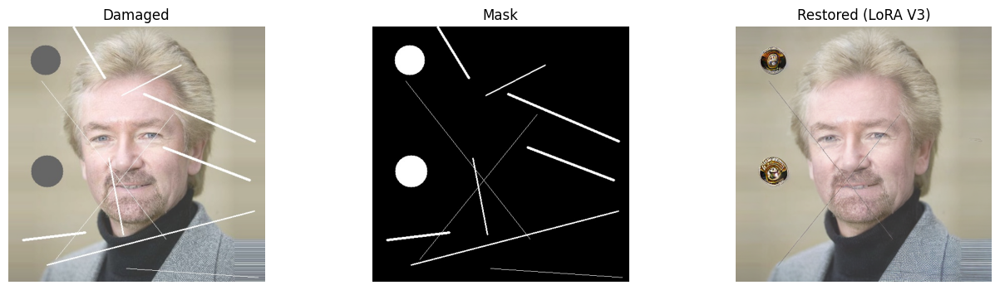

In [ ]:
from diffusers import StableDiffusionInpaintPipeline
import torch
from PIL import Image
import os
import random
import matplotlib.pyplot as plt

DEVICE = "cuda"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

pipe.load_lora_weights(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_V3_FINAL",
    weight_name="adapter_model.safetensors"
)

pipe.enable_attention_slicing()

print("FINAL LoRA loaded successfully")

BASE_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data"
DAMAGED_DIR = os.path.join(BASE_PATH, "damaged")
MASK_DIR = os.path.join(BASE_PATH, "masks")

test_fname = random.choice(os.listdir(DAMAGED_DIR))

damaged_path = os.path.join(DAMAGED_DIR, test_fname)
mask_path = os.path.join(MASK_DIR, test_fname)

damaged_pil = Image.open(damaged_path).convert("RGB").resize((512,512))
mask_pil = Image.open(mask_path).convert("L").resize((512,512))

print("Testing on:", test_fname)

with torch.no_grad():
    restored = pipe(
        prompt="high quality realistic old photo restoration, clean face, sharp details, natural skin texture",
        negative_prompt="scratches, cracks, stains, blur, distortion, artifacts",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=60,
        guidance_scale=9.0,
        strength=1.0
    ).images[0]

plt.figure(figsize=(16,4))

plt.subplot(1,3,1)
plt.title("Damaged")
plt.imshow(damaged_pil)
plt.axis("off")

plt.subplot(1,3,2)
plt.title("Mask")
plt.imshow(mask_pil, cmap="gray")
plt.axis("off")

plt.subplot(1,3,3)
plt.title("Restored (LoRA V3)")
plt.imshow(restored)
plt.axis("off")

plt.show()


In [ ]:
from diffusers import StableDiffusionInpaintPipeline
import torch, cv2, numpy as np
from PIL import Image
import matplotlib.pyplot as plt

DEVICE = "cuda"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

pipe.load_lora_weights(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_output",
    weight_name="adapter_model.safetensors"
)

pipe.unet.eval()
pipe.vae.eval()
pipe.text_encoder.eval()

print("Base model + LoRA loaded correctly")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
No LoRA keys associated to UNet2DConditionModel found with the pre

Base model + LoRA loaded correctly


In [ ]:
mask_np = np.array(mask_pil)

_, mask_clean = cv2.threshold(mask_np, 200, 255, cv2.THRESH_BINARY)

mask_pil = Image.fromarray(mask_clean).convert("L")


In [ ]:
with torch.no_grad():
    restored = pipe(
        prompt="realistic preserved human face, original identity retained",
        negative_prompt="scratches, streaks, watermark, logo, text, distortion",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=60,
        guidance_scale=6.5,
        strength=0.85
    ).images[0]


  0%|          | 0/51 [00:00<?, ?it/s]

(np.float64(-0.5), np.float64(511.5), np.float64(511.5), np.float64(-0.5))

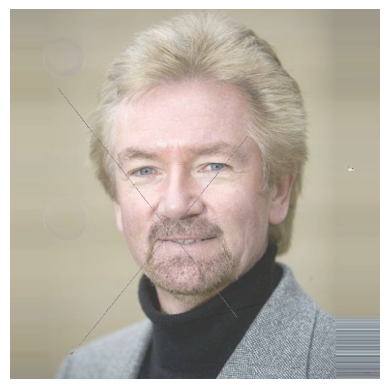

In [ ]:
rest_np = np.array(restored)
orig_np = np.array(damaged_pil)
mask_np = np.array(mask_pil) / 255.0

final = (rest_np * mask_np[..., None] + orig_np * (1 - mask_np[..., None])).astype(np.uint8)
final_pil = Image.fromarray(final)

plt.imshow(final_pil)
plt.axis("off")


(np.float64(-0.5), np.float64(511.5), np.float64(511.5), np.float64(-0.5))

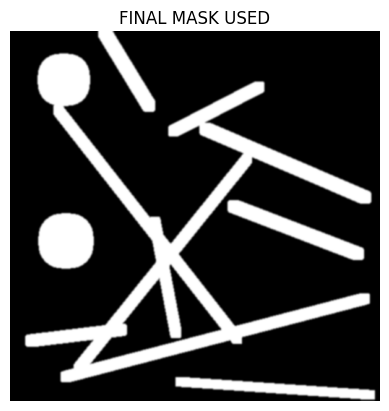

In [ ]:
import cv2
import numpy as np
from PIL import Image

mask_np = np.array(mask_pil)

_, mask_bin = cv2.threshold(mask_np, 180, 255, cv2.THRESH_BINARY)

kernel = np.ones((7,7), np.uint8)
mask_dilated = cv2.dilate(mask_bin, kernel, iterations=2)

mask_final = cv2.GaussianBlur(mask_dilated, (5,5), 0)

mask_pil = Image.fromarray(mask_final).convert("L")

plt.imshow(mask_pil, cmap="gray")
plt.title("FINAL MASK USED")
plt.axis("off")


In [ ]:
with torch.no_grad():
    restored = pipe(
        prompt="realistic preserved human face, original identity retained, natural skin texture",
        negative_prompt="scratches, cracks, stains, blur, ghosting, artifacts, distortion",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=65,
        guidance_scale=6.0,
        strength=0.82
    ).images[0]


  0%|          | 0/53 [00:00<?, ?it/s]

(np.float64(-0.5), np.float64(511.5), np.float64(511.5), np.float64(-0.5))

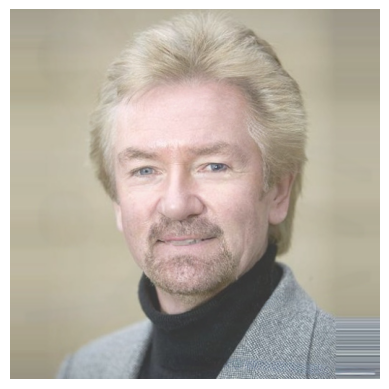

In [ ]:
rest_np = np.array(restored)
orig_np = np.array(damaged_pil)
mask_np = np.array(mask_pil) / 255.0

final = (rest_np * mask_np[..., None] + orig_np * (1 - mask_np[..., None])).astype(np.uint8)
final_pil = Image.fromarray(final)

plt.imshow(final_pil)
plt.axis("off")


  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

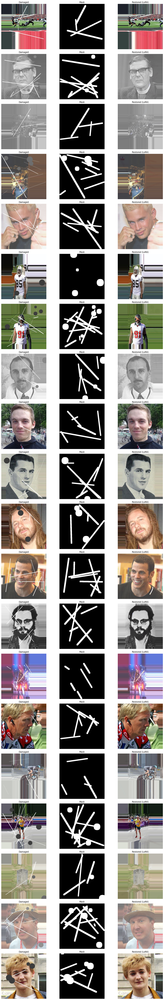

In [ ]:
import os, random, cv2, numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch

NUM_TEST_IMAGES = 20

test_files = random.sample(os.listdir(DAMAGED_DIR), NUM_TEST_IMAGES)

plt.figure(figsize=(15, 4 * NUM_TEST_IMAGES))

for i, fname in enumerate(test_files):
    damaged_path = os.path.join(DAMAGED_DIR, fname)
    mask_path    = os.path.join(MASK_DIR, fname)

    damaged_pil = Image.open(damaged_path).convert("RGB").resize((512, 512))
    mask_pil    = Image.open(mask_path).convert("L").resize((512, 512))
    mask_np = np.array(mask_pil)
    _, mask_bin = cv2.threshold(mask_np, 180, 255, cv2.THRESH_BINARY)
    kernel = np.ones((7,7), np.uint8)
    mask_dilated = cv2.dilate(mask_bin, kernel, iterations=2)
    mask_final = cv2.GaussianBlur(mask_dilated, (5,5), 0)
    mask_pil = Image.fromarray(mask_final).convert("L")

    with torch.no_grad():
        restored = pipe(
            prompt="realistic preserved human face, original identity retained, natural skin texture",
            negative_prompt="scratches, cracks, stains, blur, ghosting, artifacts, distortion",
            image=damaged_pil,
            mask_image=mask_pil,
            num_inference_steps=65,
            guidance_scale=6.0,
            strength=0.82
        ).images[0]

    rest_np = np.array(restored)
    orig_np = np.array(damaged_pil)
    mask_np = np.array(mask_pil) / 255.0
    final = (rest_np * mask_np[..., None] + orig_np * (1 - mask_np[..., None])).astype(np.uint8)
    final_pil = Image.fromarray(final)

    plt.subplot(NUM_TEST_IMAGES, 3, i*3 + 1)
    plt.imshow(damaged_pil)
    plt.title("Damaged")
    plt.axis("off")

    plt.subplot(NUM_TEST_IMAGES, 3, i*3 + 2)
    plt.imshow(mask_pil, cmap="gray")
    plt.title("Mask")
    plt.axis("off")

    plt.subplot(NUM_TEST_IMAGES, 3, i*3 + 3)
    plt.imshow(final_pil)
    plt.title("Restored (LoRA)")
    plt.axis("off")

plt.tight_layout()
plt.show()


In [ ]:
save_path = f"/content/drive/MyDrive/photo-restoration-lora-vishrutha/outputs/{fname}"
final_pil.save(save_path)


Training on Art work dataset

In [ ]:
import os

BASE_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data"

CLEAN_DIR   = os.path.join(BASE_PATH, "art_clean")
DAMAGED_DIR = os.path.join(BASE_PATH, "art_damaged")

clean_files   = sorted(os.listdir(CLEAN_DIR))
damaged_files = sorted(os.listdir(DAMAGED_DIR))

print("Clean images:", len(clean_files))
print("Damaged images:", len(damaged_files))


Clean images: 111
Damaged images: 111


In [ ]:
from PIL import Image
import os

RENAMED_CLEAN   = os.path.join(BASE_PATH, "art_clean_renamed")
RENAMED_DAMAGED = os.path.join(BASE_PATH, "art_damaged_renamed")

os.makedirs(RENAMED_CLEAN, exist_ok=True)
os.makedirs(RENAMED_DAMAGED, exist_ok=True)

N = min(len(clean_files), len(damaged_files))

for i in range(N):
    clean_src   = os.path.join(CLEAN_DIR, clean_files[i])
    damaged_src = os.path.join(DAMAGED_DIR, damaged_files[i])

    fname = f"{i:04d}.jpg"

    clean_img   = Image.open(clean_src)
    damaged_img = Image.open(damaged_src)

    if clean_img.mode != "RGB":
        clean_img = clean_img.convert("RGB")

    if damaged_img.mode != "RGB":
        damaged_img = damaged_img.convert("RGB")

    clean_dst   = os.path.join(RENAMED_CLEAN, fname)
    damaged_dst = os.path.join(RENAMED_DAMAGED, fname)

    clean_img.save(clean_dst, format="JPEG", quality=95)
    damaged_img.save(damaged_dst, format="JPEG", quality=95)

print("Renaming complete:", N, "paired images created safely")


Renaming complete: 111 paired images created safely


In [ ]:
CLEAN_DIR   = RENAMED_CLEAN
DAMAGED_DIR = RENAMED_DAMAGED
MASK_DIR    = os.path.join(BASE_PATH, "art_masks")

common_files = sorted(list(
    set(os.listdir(CLEAN_DIR)) &
    set(os.listdir(DAMAGED_DIR))
))

print("Fixed matching pairs:", len(common_files))
print(common_files[:10])


Fixed matching pairs: 111
['0000.jpg', '0001.jpg', '0002.jpg', '0003.jpg', '0004.jpg', '0005.jpg', '0006.jpg', '0007.jpg', '0008.jpg', '0009.jpg']


In [ ]:
print(len(common_files))


111


In [ ]:
import cv2
import numpy as np
from tqdm import tqdm
import os

MASK_DIR = os.path.join(BASE_PATH, "art_masks")
os.makedirs(MASK_DIR, exist_ok=True)

for fname in tqdm(os.listdir(DAMAGED_DIR)):
    damaged = cv2.imread(os.path.join(DAMAGED_DIR, fname))
    damaged = cv2.resize(damaged, (512,512))


    lab = cv2.cvtColor(damaged, cv2.COLOR_BGR2LAB)
    L, A, B = cv2.split(lab)


    edges = cv2.Canny(L, 20, 80)


    texture = cv2.Laplacian(L, cv2.CV_32F)
    texture = cv2.convertScaleAbs(texture)


    yellow_ref = np.full(B.shape, np.mean(B), dtype=np.uint8)
    yellowing = cv2.absdiff(B, yellow_ref)



    combined = (
        1.2 * texture.astype(np.float32) +
        1.4 * edges.astype(np.float32) +
        1.1 * yellowing.astype(np.float32)
    )

    combined = cv2.normalize(combined, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)


    _, mask = cv2.threshold(combined, 14, 255, cv2.THRESH_BINARY)


    kernel = np.ones((11,11), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.dilate(mask, kernel, iterations=2)


    mask = cv2.GaussianBlur(mask, (7,7), 0)

    cv2.imwrite(os.path.join(MASK_DIR, fname), mask)

print("REAL ART MASKS GENERATED (NO CLEAN REQUIRED)")



100%|██████████| 111/111 [00:02<00:00, 38.48it/s]

REAL ART MASKS GENERATED (NO CLEAN REQUIRED)


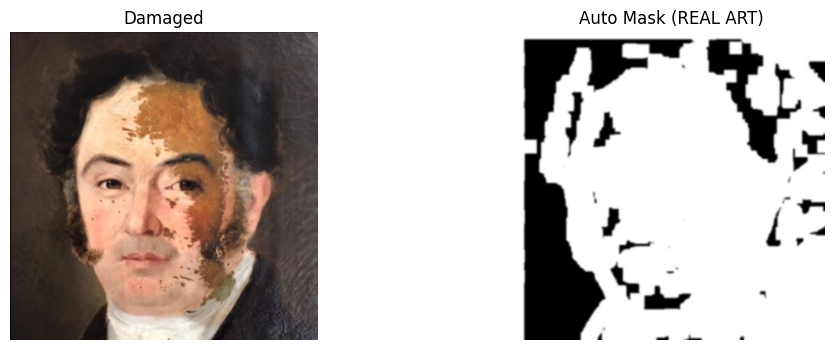

In [ ]:
import random
from PIL import Image
import matplotlib.pyplot as plt

test_fname = random.choice(os.listdir(DAMAGED_DIR))

damaged = Image.open(os.path.join(DAMAGED_DIR, test_fname)).resize((512,512))
mask    = Image.open(os.path.join(MASK_DIR, test_fname)).resize((512,512))

plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
plt.imshow(damaged)
plt.title("Damaged")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(mask, cmap="gray")
plt.title("Auto Mask (REAL ART)")
plt.axis("off")

plt.show()


In [ ]:
import cv2
import numpy as np
from tqdm import tqdm
import os

MASK_DIR = os.path.join(BASE_PATH, "art_masks_FINAL")
os.makedirs(MASK_DIR, exist_ok=True)

for fname in tqdm(os.listdir(DAMAGED_DIR)):
    damaged = cv2.imread(os.path.join(DAMAGED_DIR, fname))
    damaged = cv2.resize(damaged, (512,512))

    lab = cv2.cvtColor(damaged, cv2.COLOR_BGR2LAB)
    L, A, B = cv2.split(lab)


    edges = cv2.Canny(L, 30, 120)


    texture = cv2.Laplacian(L, cv2.CV_32F)
    texture = cv2.convertScaleAbs(texture)


    yellow_ref = np.full(B.shape, np.mean(B), dtype=np.uint8)
    yellowing  = cv2.absdiff(B, yellow_ref)


    combined = (
        0.9  * texture.astype(np.float32) +
        1.1  * edges.astype(np.float32) +
        0.6  * yellowing.astype(np.float32)
    )

    combined = cv2.normalize(combined, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)


    _, mask = cv2.threshold(combined, 38, 255, cv2.THRESH_BINARY)


    kernel = np.ones((5,5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=1)
    mask = cv2.dilate(mask, kernel, iterations=1)


    mask = cv2.GaussianBlur(mask, (5,5), 0)

    cv2.imwrite(os.path.join(MASK_DIR, fname), mask)

print("FINAL REAL-ART MASKS GENERATED (TUNED)")


100%|██████████| 111/111 [00:02<00:00, 38.16it/s]

FINAL REAL-ART MASKS GENERATED (TUNED)


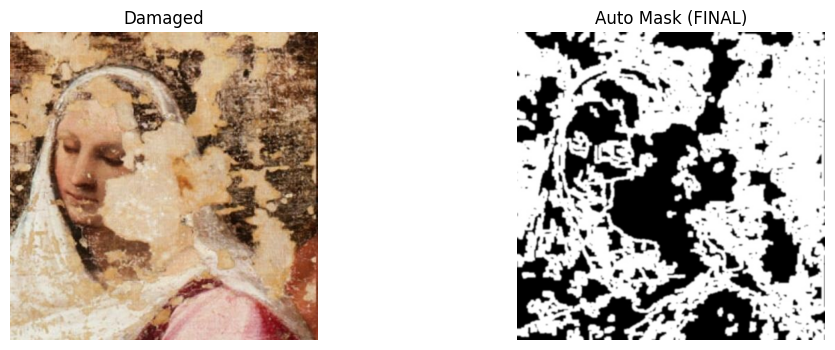

In [ ]:
test_fname = random.choice(os.listdir(DAMAGED_DIR))
damaged = Image.open(os.path.join(DAMAGED_DIR, test_fname)).resize((512,512))
mask    = Image.open(os.path.join(MASK_DIR, test_fname)).resize((512,512))

plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
plt.imshow(damaged)
plt.title("Damaged")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(mask, cmap="gray")
plt.title("Auto Mask (FINAL)")
plt.axis("off")

plt.show()


In [ ]:
import cv2
import numpy as np
from tqdm import tqdm
import os

MASK_DIR = os.path.join(BASE_PATH, "art_masks_FINAL_V2")
os.makedirs(MASK_DIR, exist_ok=True)

for fname in tqdm(os.listdir(DAMAGED_DIR)):
    img = cv2.imread(os.path.join(DAMAGED_DIR, fname))
    img = cv2.resize(img, (512,512))

    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)

    H, S, V = cv2.split(hsv)
    L, A, B = cv2.split(lab)


    pigment_loss = cv2.inRange(S, 0, 60) & cv2.inRange(V, 140, 255)


    yellow_ref = np.full(B.shape, np.mean(B), dtype=np.uint8)
    yellowing = cv2.absdiff(B, yellow_ref)
    _, yellow_mask = cv2.threshold(yellowing, 35, 255, cv2.THRESH_BINARY)


    edges = cv2.Canny(L, 60, 140)


    combined = (
        1.5  * pigment_loss.astype(np.float32) +
        1.0  * yellow_mask.astype(np.float32) +
        0.5  * edges.astype(np.float32)
    )

    combined = cv2.normalize(combined, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)


    _, mask = cv2.threshold(combined, 85, 255, cv2.THRESH_BINARY)


    mask = cv2.medianBlur(mask, 7)


    kernel = np.ones((7,7), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=1)


    mask = cv2.GaussianBlur(mask, (7,7), 0)

    cv2.imwrite(os.path.join(MASK_DIR, fname), mask)

print("REAL ART MASKS (CLEAN VERSION) GENERATED")


100%|██████████| 111/111 [00:03<00:00, 27.87it/s]

REAL ART MASKS (CLEAN VERSION) GENERATED


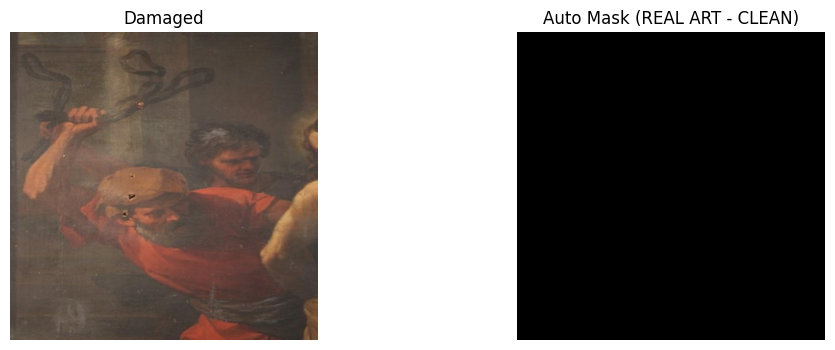

In [ ]:
test_fname = random.choice(os.listdir(DAMAGED_DIR))

damaged = Image.open(os.path.join(DAMAGED_DIR, test_fname)).resize((512,512))
mask    = Image.open(os.path.join(MASK_DIR, test_fname)).resize((512,512))

plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
plt.imshow(damaged)
plt.title("Damaged")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(mask, cmap="gray")
plt.title("Auto Mask (REAL ART - CLEAN)")
plt.axis("off")

plt.show()


In [ ]:
import cv2
import numpy as np
from tqdm import tqdm
import os

MASK_DIR = os.path.join(BASE_PATH, "art_masks_FINAL_V3")
os.makedirs(MASK_DIR, exist_ok=True)

for fname in tqdm(os.listdir(DAMAGED_DIR)):
    img = cv2.imread(os.path.join(DAMAGED_DIR, fname))
    img = cv2.resize(img, (512,512))

    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)

    H, S, V = cv2.split(hsv)
    L, A, B = cv2.split(lab)


    pigment_loss = cv2.inRange(S, 0, 90) & cv2.inRange(V, 115, 255)


    yellow_ref = np.full(B.shape, np.mean(B), dtype=np.uint8)
    yellowing = cv2.absdiff(B, yellow_ref)
    _, yellow_mask = cv2.threshold(yellowing, 18, 255, cv2.THRESH_BINARY)


    edges = cv2.Canny(L, 40, 110)


    combined = (
        1.2 * pigment_loss.astype(np.float32) +
        1.0 * yellow_mask.astype(np.float32) +
        0.3 * edges.astype(np.float32)
    )

    combined = cv2.normalize(combined, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)


    _, mask = cv2.threshold(combined, 55, 255, cv2.THRESH_BINARY)


    mask = cv2.medianBlur(mask, 5)


    kernel = np.ones((5,5), np.uint8)
    mask = cv2.dilate(mask, kernel, iterations=1)


    mask = cv2.GaussianBlur(mask, (5,5), 0)

    cv2.imwrite(os.path.join(MASK_DIR, fname), mask)

print("REAL ART MASKS (V3 UNIVERSAL) GENERATED")


100%|██████████| 111/111 [00:02<00:00, 38.57it/s]

REAL ART MASKS (V3 UNIVERSAL) GENERATED


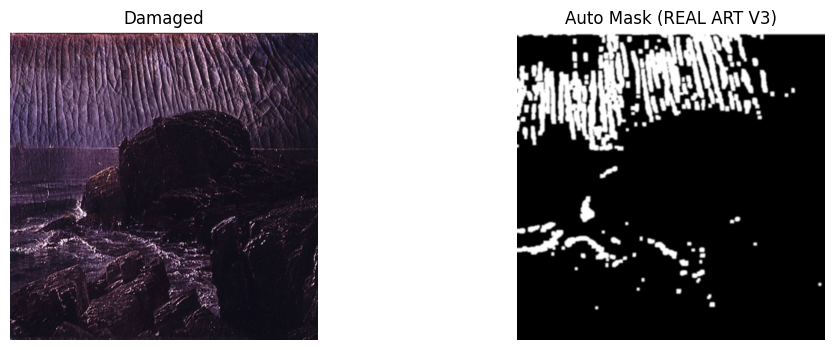

In [ ]:
test_fname = random.choice(os.listdir(DAMAGED_DIR))

damaged = Image.open(os.path.join(DAMAGED_DIR, test_fname)).resize((512,512))
mask    = Image.open(os.path.join(MASK_DIR, test_fname)).resize((512,512))

plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
plt.imshow(damaged)
plt.title("Damaged")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(mask, cmap="gray")
plt.title("Auto Mask (REAL ART V3)")
plt.axis("off")

plt.show()


In [ ]:
import cv2
import numpy as np
from tqdm import tqdm
import os

MASK_DIR = os.path.join(BASE_PATH, "art_masks_FINAL_V4")
os.makedirs(MASK_DIR, exist_ok=True)

for fname in tqdm(os.listdir(DAMAGED_DIR)):
    img = cv2.imread(os.path.join(DAMAGED_DIR, fname))
    img = cv2.resize(img, (512,512))

    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    H, S, V = cv2.split(hsv)
    L, A, B = cv2.split(lab)

    # 1. Strong oxidation / yellow stains
    yellow_ref = np.full(B.shape, np.mean(B), dtype=np.uint8)
    yellowing = cv2.absdiff(B, yellow_ref)
    _, yellow_mask = cv2.threshold(yellowing, 16, 255, cv2.THRESH_BINARY)

    # 2. Pigment loss (washed-out regions)
    pigment_loss = cv2.inRange(S, 0, 70) & cv2.inRange(V, 120, 240)

    # 3. Crack detection (suppressed texture)
    edges = cv2.Canny(gray, 60, 140)
    edges = cv2.morphologyEx(edges, cv2.MORPH_OPEN, np.ones((3,3),np.uint8))

    # 4. Density filtering (removes fabric & water texture)
    texture_suppress = cv2.GaussianBlur(gray, (21,21), 0)
    texture_diff = cv2.absdiff(gray, texture_suppress)
    _, texture_mask = cv2.threshold(texture_diff, 14, 255, cv2.THRESH_BINARY)

    # 5. Final fusion (damage-focused)
    combined = (
        1.4 * yellow_mask.astype(np.float32) +
        1.1 * pigment_loss.astype(np.float32) +
        0.6 * edges.astype(np.float32) +
        0.8 * texture_mask.astype(np.float32)
    )

    combined = cv2.normalize(combined, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # 6. Balanced threshold (prevents texture takeover)
    _, mask = cv2.threshold(combined, 92, 255, cv2.THRESH_BINARY)

    # 7. Remove tiny speckles
    kernel = np.ones((5,5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # 8. Grow real damage slightly
    mask = cv2.dilate(mask, kernel, iterations=1)

    # 9. Feather edges for SD inpainting
    mask = cv2.GaussianBlur(mask, (7,7), 0)

    cv2.imwrite(os.path.join(MASK_DIR, fname), mask)

print("REAL ART DAMAGE MASKS (V4) GENERATED")


100%|██████████| 111/111 [00:02<00:00, 38.04it/s]

REAL ART DAMAGE MASKS (V4) GENERATED


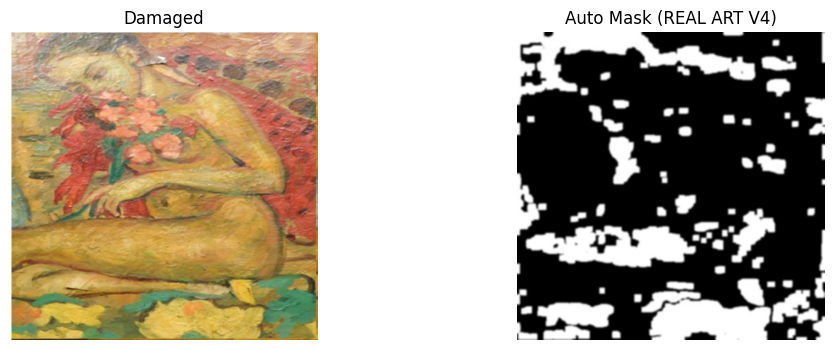

In [ ]:
test_fname = random.choice(os.listdir(DAMAGED_DIR))

damaged = Image.open(os.path.join(DAMAGED_DIR, test_fname)).resize((512,512))
mask    = Image.open(os.path.join(MASK_DIR, test_fname)).resize((512,512))

plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
plt.imshow(damaged)
plt.title("Damaged")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(mask, cmap="gray")
plt.title("Auto Mask (REAL ART V4)")
plt.axis("off")

plt.show()


In [ ]:
MASK_DIR = os.path.join(BASE_PATH, "art_masks_FINAL_V5")
os.makedirs(MASK_DIR, exist_ok=True)

for fname in tqdm(os.listdir(DAMAGED_DIR)):
    img = cv2.imread(os.path.join(DAMAGED_DIR, fname))
    img = cv2.resize(img, (512,512))

    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    H, S, V = cv2.split(hsv)
    L, A, B = cv2.split(lab)

    # 1. Local yellow deviation (removes uniform aging)
    blur_B = cv2.GaussianBlur(B, (41,41), 0)
    yellow_local = cv2.absdiff(B, blur_B)
    _, yellow_mask = cv2.threshold(yellow_local, 22, 255, cv2.THRESH_BINARY)

    # 2. True pigment loss (low saturation + mid brightness)
    pigment_loss = cv2.inRange(S, 0, 55) & cv2.inRange(V, 120, 215)

    # 3. Crack detection (gentle)
    edges = cv2.Canny(gray, 80, 160)

    # 4. Paint peeling detection (texture spikes only)
    blur_tex = cv2.GaussianBlur(gray, (25,25), 0)
    tex_diff = cv2.absdiff(gray, blur_tex)
    _, tex_mask = cv2.threshold(tex_diff, 18, 255, cv2.THRESH_BINARY)

    # 5. Weighted fusion (damage-biased)
    combined = (
        1.6 * yellow_mask.astype(np.float32) +
        1.4 * pigment_loss.astype(np.float32) +
        0.6 * edges.astype(np.float32) +
        0.9 * tex_mask.astype(np.float32)
    )

    combined = cv2.normalize(combined, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # 6. Hard separation between aging & true damage
    _, mask = cv2.threshold(combined, 118, 255, cv2.THRESH_BINARY)

    # 7. Remove isolated noise
    kernel = np.ones((7,7), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # 8. Damage expansion
    mask = cv2.dilate(mask, kernel, iterations=1)

    # 9. Soft inpaint boundaries
    mask = cv2.GaussianBlur(mask, (9,9), 0)

    cv2.imwrite(os.path.join(MASK_DIR, fname), mask)

print("ARTWORK DAMAGE MASKS (V5) GENERATED")


100%|██████████| 111/111 [00:03<00:00, 30.25it/s]

ARTWORK DAMAGE MASKS (V5) GENERATED


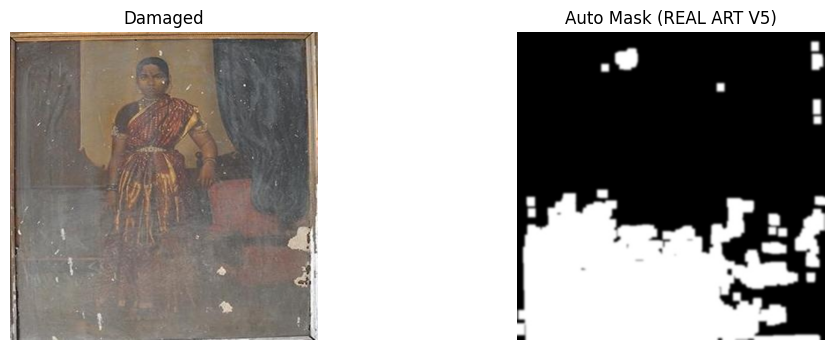

In [ ]:
test_fname = random.choice(os.listdir(DAMAGED_DIR))

damaged = Image.open(os.path.join(DAMAGED_DIR, test_fname)).resize((512,512))
mask    = Image.open(os.path.join(MASK_DIR, test_fname)).resize((512,512))

plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
plt.imshow(damaged)
plt.title("Damaged")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(mask, cmap="gray")
plt.title("Auto Mask (REAL ART V5)")
plt.axis("off")

plt.show()

In [ ]:
MASK_DIR = os.path.join(BASE_PATH, "art_masks_FINAL_V5_1")
os.makedirs(MASK_DIR, exist_ok=True)

for fname in tqdm(os.listdir(DAMAGED_DIR)):
    img = cv2.imread(os.path.join(DAMAGED_DIR, fname))
    img = cv2.resize(img, (512,512))

    hsv  = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lab  = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    H, S, V = cv2.split(hsv)
    L, A, B = cv2.split(lab)


    blur_B = cv2.GaussianBlur(B, (61,61), 0)
    yellow_local = cv2.absdiff(B, blur_B)
    _, yellow_mask = cv2.threshold(yellow_local, 12, 255, cv2.THRESH_BINARY)



    pigment_loss = cv2.inRange(S, 0, 70) & cv2.inRange(V, 105, 230)


    edges = cv2.Canny(gray, 80, 160)


    blur_tex = cv2.GaussianBlur(gray, (25,25), 0)
    tex_diff = cv2.absdiff(gray, blur_tex)
    _, tex_mask = cv2.threshold(tex_diff, 18, 255, cv2.THRESH_BINARY)


    combined = (
    2.1 * yellow_mask.astype(np.float32) +
    1.6 * pigment_loss.astype(np.float32) +
    0.7 * edges.astype(np.float32) +
    1.1 * tex_mask.astype(np.float32)
    )

    combined = cv2.normalize(combined, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)



    _, mask = cv2.threshold(combined, 38, 255, cv2.THRESH_BINARY)



    kernel = np.ones((5,5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)


    mask = cv2.dilate(mask, kernel, iterations=1)


    mask = cv2.GaussianBlur(mask, (9,9), 0)

    cv2.imwrite(os.path.join(MASK_DIR, fname), mask)

print("ARTWORK DAMAGE MASKS (V6) GENERATED")


100%|██████████| 111/111 [00:05<00:00, 19.73it/s]

ARTWORK DAMAGE MASKS (V6) GENERATED


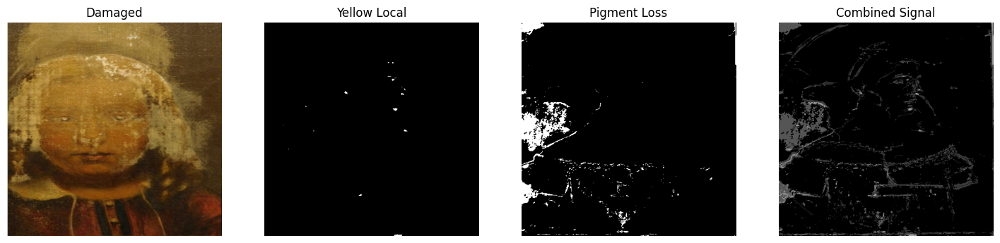

In [ ]:
plt.figure(figsize=(18,4))

plt.subplot(1,4,1)
plt.imshow(damaged)
plt.title("Damaged")
plt.axis("off")

plt.subplot(1,4,2)
plt.imshow(yellow_mask, cmap="gray")
plt.title("Yellow Local")
plt.axis("off")

plt.subplot(1,4,3)
plt.imshow(pigment_loss, cmap="gray")
plt.title("Pigment Loss")
plt.axis("off")

plt.subplot(1,4,4)
plt.imshow(combined, cmap="gray")
plt.title("Combined Signal")
plt.axis("off")

plt.show()


In [ ]:
import os

FINAL_MASK_DIR = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/art_masks_REAL_FINAL"
os.makedirs(FINAL_MASK_DIR, exist_ok=True)

print("Final mask folder ready:", FINAL_MASK_DIR)


Final mask folder ready: /content/drive/MyDrive/photo-restoration-lora-vishrutha/art_masks_REAL_FINAL


In [ ]:
import cv2
import numpy as np
import os
from PIL import Image
from tqdm import tqdm

DAMAGED_DIR = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/art_damaged"
FINAL_MASK_DIR = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/art_masks_REAL_FINAL"

os.makedirs(FINAL_MASK_DIR, exist_ok=True)

THRESH = 38
KERNEL = np.ones((5,5), np.uint8)

for fname in tqdm(os.listdir(DAMAGED_DIR)):
  valid_files = [f for f in os.listdir(DAMAGED_DIR) if f.lower().endswith((".jpg", ".png")) and not f.startswith(".")]

print("Using only", len(valid_files), "real damaged images")

for fname in tqdm(valid_files):


    img = cv2.imread(os.path.join(DAMAGED_DIR, fname))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)


    edges = cv2.Canny(gray, 80, 160)


    texture = cv2.Laplacian(gray, cv2.CV_64F)
    texture = np.uint8(np.abs(texture))


    B = img[:,:,2].astype(np.uint8)
    B_mean = np.full(B.shape, int(B.mean()), dtype=np.uint8)
    yellowing = cv2.absdiff(B, B_mean)



    combined = (
        0.5 * edges +
        0.8 * texture +
        0.4 * yellowing
    ).astype(np.uint8)


    _, mask = cv2.threshold(combined, THRESH, 255, cv2.THRESH_BINARY)


    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, KERNEL)
    mask = cv2.GaussianBlur(mask, (5,5), 0)


    Image.fromarray(mask).save(
        os.path.join(FINAL_MASK_DIR, fname)
    )

print("FINAL REAL-ART MASKS GENERATED")


100%|██████████| 111/111 [00:00<00:00, 1047.12it/s]


Using only 110 real damaged images


100%|██████████| 110/110 [00:04<00:00, 26.03it/s]

FINAL REAL-ART MASKS GENERATED


In [ ]:
CLEAN_DIR  = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/art_clean"
DAMAGED_DIR = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/art_damaged"
MASK_DIR   = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/art_masks_REAL_FINAL"

clean_files   = set(os.listdir(CLEAN_DIR))
damaged_files = set(os.listdir(DAMAGED_DIR))
mask_files    = set(os.listdir(MASK_DIR))

common = sorted(list(clean_files & damaged_files & mask_files))

print("Clean images:", len(clean_files))
print("Damaged images:", len(damaged_files))
print("Masks:", len(mask_files))
print("PERFECTLY MATCHED TRIPLETS:", len(common))

common[:10]


Clean images: 111
Damaged images: 111
Masks: 110
PERFECTLY MATCHED TRIPLETS: 109


['001.jpg',
 '002.png',
 '003.jpg',
 '004.png',
 '005.png',
 '006.png',
 '007.jpg',
 '009.png',
 '010.png',
 '011.png']

In [ ]:
import os
import shutil
from tqdm import tqdm

BASE = "/content/drive/MyDrive/photo-restoration-lora-vishrutha"

CLEAN_DIR   = f"{BASE}/data/art_clean"
DAMAGED_DIR = f"{BASE}/data/art_damaged"
MASK_DIR    = f"{BASE}/art_masks_REAL_FINAL"

FINAL_BASE = f"{BASE}/data/train"
FINAL_CLEAN   = f"{FINAL_BASE}/clean"
FINAL_DAMAGED = f"{FINAL_BASE}/damaged"
FINAL_MASK    = f"{FINAL_BASE}/mask"

os.makedirs(FINAL_CLEAN, exist_ok=True)
os.makedirs(FINAL_DAMAGED, exist_ok=True)
os.makedirs(FINAL_MASK, exist_ok=True)

clean_files   = set(os.listdir(CLEAN_DIR))
damaged_files = set(os.listdir(DAMAGED_DIR))
mask_files    = set(os.listdir(MASK_DIR))

COMMON = sorted(list(clean_files & damaged_files & mask_files))

print("FINAL LOCKED TRAINING PAIRS:", len(COMMON))

for fname in tqdm(COMMON):
    shutil.copy(
        os.path.join(CLEAN_DIR, fname),
        os.path.join(FINAL_CLEAN, fname)
    )
    shutil.copy(
        os.path.join(DAMAGED_DIR, fname),
        os.path.join(FINAL_DAMAGED, fname)
    )
    shutil.copy(
        os.path.join(MASK_DIR, fname),
        os.path.join(FINAL_MASK, fname)
    )

print("FINAL TRAINING DATASET CREATED:")
print(FINAL_BASE)


FINAL LOCKED TRAINING PAIRS: 109


100%|██████████| 109/109 [06:57<00:00,  3.83s/it]

FINAL TRAINING DATASET CREATED:
/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/train


In [ ]:
BASE = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/train"

CLEAN_DIR   = f"{BASE}/clean"
DAMAGED_DIR = f"{BASE}/damaged"
MASK_DIR    = f"{BASE}/mask"

print("CLEAN:", len(os.listdir(CLEAN_DIR)))
print("DAMAGED:", len(os.listdir(DAMAGED_DIR)))
print("MASK:", len(os.listdir(MASK_DIR)))


CLEAN: 109
DAMAGED: 109
MASK: 109


In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os

class RealArtInpaintDataset(Dataset):
    def __init__(self, clean_dir, damaged_dir, mask_dir):
        self.clean_dir = clean_dir
        self.damaged_dir = damaged_dir
        self.mask_dir = mask_dir

        self.files = sorted(list(
            set(os.listdir(clean_dir)) &
            set(os.listdir(damaged_dir)) &
            set(os.listdir(mask_dir))
        ))

        self.img_tf = transforms.Compose([
            transforms.Resize((512,512)),
            transforms.ToTensor(),
            transforms.Normalize([0.5]*3, [0.5]*3)
        ])

        self.mask_tf = transforms.Compose([
            transforms.Resize((512,512)),
            transforms.ToTensor()
        ])

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        fname = self.files[idx]

        clean   = Image.open(os.path.join(self.clean_dir, fname)).convert("RGB")
        damaged = Image.open(os.path.join(self.damaged_dir, fname)).convert("RGB")
        mask    = Image.open(os.path.join(self.mask_dir, fname)).convert("L")

        return {
            "clean": self.img_tf(clean),
            "damaged": self.img_tf(damaged),
            "mask": self.mask_tf(mask),
        }

dataset = RealArtInpaintDataset(CLEAN_DIR, DAMAGED_DIR, MASK_DIR)

loader = DataLoader(
    dataset,
    batch_size=1,
    shuffle=True,
    num_workers=0,
    pin_memory=True
)

print("REAL ART DATASET READY:", len(dataset))


REAL ART DATASET READY: 109


In [ ]:
import torch
from diffusers import StableDiffusionInpaintPipeline
from diffusers import DDPMScheduler

DEVICE = "cuda"

BASE_MODEL = "runwayml/stable-diffusion-inpainting"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    BASE_MODEL,
    torch_dtype=torch.float32
).to(DEVICE)

pipe.scheduler = DDPMScheduler.from_pretrained(BASE_MODEL, subfolder="scheduler")

pipe.safety_checker = None
pipe.requires_safety_checker = False


pipe.enable_attention_slicing()
pipe.enable_vae_slicing()
pipe.vae.eval()
pipe.text_encoder.eval()

print("Base pipeline loaded safely")


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/548 [00:00<?, ?B/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/748 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

config.json: 0.00B [00:00, ?B/s]

scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

text_encoder/pytorch_model.bin:   0%|          | 0.00/492M [00:00<?, ?B/s]

safety_checker/pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/552 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


Base pipeline loaded safely


In [ ]:
LORA_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_V3_FINAL"


pipe.load_lora_weights(
    LORA_PATH,
    weight_name="adapter_model.safetensors"
)

print("REAL ART LoRA loaded")


No LoRA keys associated to UNet2DConditionModel found with the prefix='unet'. This is safe to ignore if LoRA state dict didn't originally have any UNet2DConditionModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new
No LoRA keys associated to CLIPTextModel found with the prefix='text_encoder'. This is safe to ignore if LoRA state dict didn't originally have any CLIPTextModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new


REAL ART LoRA loaded


In [ ]:
import os
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torchvision.transforms as T

BASE_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/train"

CLEAN_DIR   = os.path.join(BASE_PATH, "clean")
DAMAGED_DIR = os.path.join(BASE_PATH, "damaged")
MASK_DIR    = os.path.join(BASE_PATH, "mask")

files = sorted(os.listdir(CLEAN_DIR))
print("Final training images:", len(files))

img_tf = T.Compose([
    T.Resize((512,512)),
    T.ToTensor(),
])

mask_tf = T.Compose([
    T.Resize((512,512)),
    T.ToTensor(),
])

class RealArtDataset(Dataset):
    def __init__(self):
        self.files = files

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        fname = self.files[idx]

        clean   = Image.open(os.path.join(CLEAN_DIR, fname)).convert("RGB")
        damaged = Image.open(os.path.join(DAMAGED_DIR, fname)).convert("RGB")
        mask    = Image.open(os.path.join(MASK_DIR, fname)).convert("L")

        return {
            "clean": img_tf(clean),
            "damaged": img_tf(damaged),
            "mask": mask_tf(mask)
        }

dataset = RealArtDataset()
loader = DataLoader(dataset, batch_size=1, shuffle=True, num_workers=2, pin_memory=True)

print("DataLoader ready")


Final training images: 109
DataLoader ready


In [ ]:
from torch.optim import AdamW
import torch.nn.functional as F
import torch
from tqdm.auto import tqdm

pipe.unet.train()
pipe.unet.float()

LR = 2e-5
EPOCHS = 2

optimizer = AdamW(pipe.unet.parameters(), lr=LR)

for epoch in range(EPOCHS):
    total_loss = 0.0
    valid_steps = 0

    for i, batch in enumerate(tqdm(loader)):

        clean   = batch["clean"].to(DEVICE)
        damaged = batch["damaged"].to(DEVICE)
        mask    = batch["mask"].to(DEVICE)

        mask = torch.clamp(mask, 0, 1)

        with torch.no_grad():
            clean_latents   = pipe.vae.encode(clean).latent_dist.sample() * 0.18215
            damaged_latents = pipe.vae.encode(damaged).latent_dist.sample() * 0.18215

            mask_latent = torch.nn.functional.interpolate(
                mask, size=clean_latents.shape[-2:], mode="nearest"
            )

        noise = torch.randn_like(clean_latents)

        timesteps = torch.randint(
            0,
            pipe.scheduler.config.num_train_timesteps,
            (clean_latents.shape[0],),
            device=clean_latents.device
        ).long()

        noisy_latents = pipe.scheduler.add_noise(
            clean_latents, noise, timesteps
        )

        latent_model_input = torch.cat(
            [noisy_latents, damaged_latents, mask_latent], dim=1
        )

        text_ids = pipe.tokenizer(
            [""] * clean_latents.shape[0],
            return_tensors="pt"
        ).input_ids.to(DEVICE)

        with torch.no_grad():
            text_embeds = pipe.text_encoder(text_ids)[0]

        model_pred = pipe.unet(
            latent_model_input,
            timesteps,
            encoder_hidden_states=text_embeds
        ).sample

        weight = mask_latent * 1.0 + 0.1
        loss = F.mse_loss(model_pred * weight, noise * weight)

        if not torch.isfinite(loss):

            continue

        optimizer.zero_grad(set_to_none=True)
        loss.backward()
        torch.nn.utils.clip_grad_norm_(pipe.unet.parameters(), 1.0)
        optimizer.step()

        total_loss += loss.item()
        valid_steps += 1

        if epoch == 0 and i < 3:
            print("Step", i, "loss:", loss.item())

    avg = total_loss / valid_steps
    print(f"Epoch {epoch+1} DONE | Avg Loss: {avg:.6f}")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
No LoRA keys associated to UNet2DConditionModel found with the pre

Final real-art LoRA loaded for inference


  0%|          | 0/51 [00:00<?, ?it/s]

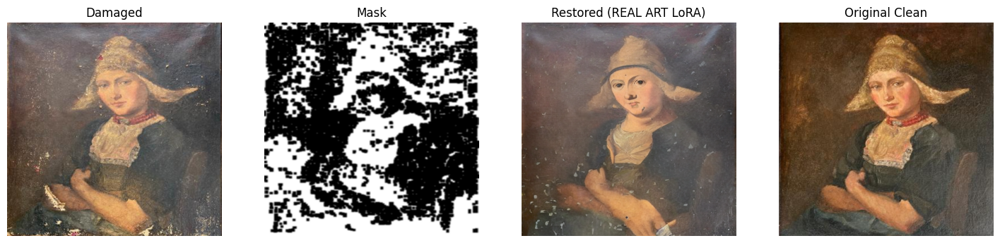

In [ ]:
from diffusers import StableDiffusionInpaintPipeline
import torch
from PIL import Image
import matplotlib.pyplot as plt
import os, random

DEVICE = "cuda"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

pipe.load_lora_weights(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_REAL_ART_FINAL",
    weight_name="adapter_model.safetensors"
)

pipe.enable_attention_slicing()
pipe.enable_vae_slicing()

print("Final real-art LoRA loaded for inference")

# Pick a random REAL damaged artwork
BASE_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/train"
DAMAGED_DIR = os.path.join(BASE_PATH, "damaged")
MASK_DIR    = os.path.join(BASE_PATH, "mask")
CLEAN_DIR   = os.path.join(BASE_PATH, "clean")

fname = random.choice(os.listdir(DAMAGED_DIR))

damaged = Image.open(os.path.join(DAMAGED_DIR, fname)).convert("RGB").resize((512,512))
mask    = Image.open(os.path.join(MASK_DIR, fname)).convert("L").resize((512,512))
clean   = Image.open(os.path.join(CLEAN_DIR, fname)).convert("RGB").resize((512,512))

with torch.no_grad():
    restored = pipe(
        prompt="museum-quality artwork restoration, preserve original brush strokes, remove cracks and peeling",
        negative_prompt="distortion, fake texture, low quality, over smoothing",
        image=damaged,
        mask_image=mask,
        num_inference_steps=60,
        guidance_scale=7.0,
        strength=0.85
    ).images[0]

plt.figure(figsize=(18,4))

plt.subplot(1,4,1)
plt.imshow(damaged)
plt.title("Damaged")
plt.axis("off")

plt.subplot(1,4,2)
plt.imshow(mask, cmap="gray")
plt.title("Mask")
plt.axis("off")

plt.subplot(1,4,3)
plt.imshow(restored)
plt.title("Restored (REAL ART LoRA)")
plt.axis("off")

plt.subplot(1,4,4)
plt.imshow(clean)
plt.title("Original Clean")
plt.axis("off")

plt.show()


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
No LoRA keys associated to UNet2DConditionModel found with the pre

Ultra-Realism LoRA Loaded


  0%|          | 0/54 [00:00<?, ?it/s]

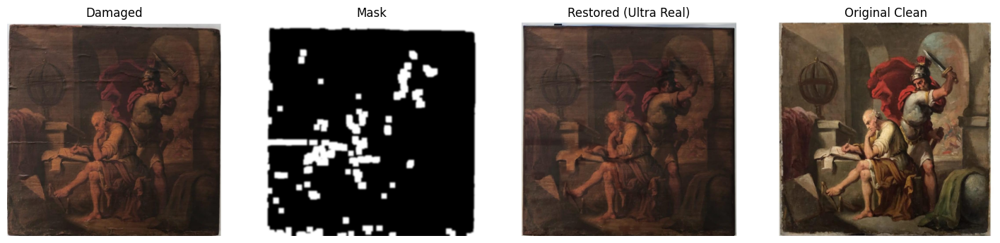

In [ ]:
import torch
from diffusers import StableDiffusionInpaintPipeline
from PIL import Image
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os, random

DEVICE = "cuda"

# -------------------------------
# LOAD PIPELINE + LoRA
# -------------------------------
pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

pipe.load_lora_weights(
    "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_V3_FINAL",
    weight_name="adapter_model.safetensors"
)

pipe.enable_attention_slicing()

pipe.unet.eval()
pipe.vae.eval()
pipe.text_encoder.eval()

print("Ultra-Realism LoRA Loaded")

# -------------------------------
# LOAD TEST IMAGE
# -------------------------------
BASE_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/train"
DAMAGED_DIR = f"{BASE_PATH}/damaged"
MASK_DIR    = f"{BASE_PATH}/mask"
CLEAN_DIR   = f"{BASE_PATH}/clean"

fname = random.choice(os.listdir(DAMAGED_DIR))

damaged_pil = Image.open(os.path.join(DAMAGED_DIR, fname)).convert("RGB").resize((512,512))
mask_pil    = Image.open(os.path.join(MASK_DIR, fname)).convert("L").resize((512,512))
clean_pil   = Image.open(os.path.join(CLEAN_DIR, fname)).convert("RGB").resize((512,512))

# -------------------------------
# MASK REFINEMENT (CRITICAL)
# -------------------------------
mask_np = np.array(mask_pil)
_, mask_bin = cv2.threshold(mask_np, 160, 255, cv2.THRESH_BINARY)
kernel = np.ones((7,7), np.uint8)
mask_dilated = cv2.dilate(mask_bin, kernel, iterations=2)
mask_soft = cv2.GaussianBlur(mask_dilated, (9,9), 0)
mask_pil = Image.fromarray(mask_soft).convert("L")

# -------------------------------
# ULTRA-REALISM PROMPTING
# -------------------------------
PROMPT = (
    "museum quality oil painting restoration, "
    "original subject identity preserved, "
    "natural skin pores, realistic oil brush texture, "
    "soft directional lighting, no artificial smoothing, "
    "true historical paint color palette"
)

NEG_PROMPT = (
    "plastic skin, wax face, artificial lighting, "
    "oversharpen, digital texture, face distortion, "
    "identity change, blur, fog, halos, artifacts"
)

# -------------------------------
# INFERENCE (REALISM TUNED)
# -------------------------------
with torch.no_grad():
    restored = pipe(
        prompt=PROMPT,
        negative_prompt=NEG_PROMPT,
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=70,
        guidance_scale=6.0,
        strength=0.78
    ).images[0]

# -------------------------------
# SMART BLEND WITH ORIGINAL
# -------------------------------
rest_np  = np.array(restored).astype(np.float32)
orig_np  = np.array(damaged_pil).astype(np.float32)
mask_np  = np.array(mask_pil).astype(np.float32) / 255.0

# softer blending to keep original texture
final = (rest_np * mask_np[...,None] * 0.85 + orig_np * (1 - mask_np[...,None])).astype(np.uint8)
final_pil = Image.fromarray(final)

# -------------------------------
# SHOW RESULTS
# -------------------------------
plt.figure(figsize=(18,4))
plt.subplot(1,4,1); plt.title("Damaged"); plt.imshow(damaged_pil); plt.axis("off")
plt.subplot(1,4,2); plt.title("Mask"); plt.imshow(mask_pil, cmap="gray"); plt.axis("off")
plt.subplot(1,4,3); plt.title("Restored (Ultra Real)"); plt.imshow(final_pil); plt.axis("off")
plt.subplot(1,4,4); plt.title("Original Clean"); plt.imshow(clean_pil); plt.axis("off")
plt.show()


In [ ]:
import cv2
import numpy as np
from PIL import Image

mask_np = np.array(mask_pil)

# 1. Binarize cleanly
_, mask_bin = cv2.threshold(mask_np, 140, 255, cv2.THRESH_BINARY)

# 2. Remove isolated noise
kernel = np.ones((7,7), np.uint8)
mask_bin = cv2.morphologyEx(mask_bin, cv2.MORPH_CLOSE, kernel)
mask_bin = cv2.morphologyEx(mask_bin, cv2.MORPH_OPEN, kernel)

# 3. Expand slightly for full crack coverage
mask_bin = cv2.dilate(mask_bin, kernel, iterations=2)

# 4. Feather edges for **natural blend**
mask_soft = cv2.GaussianBlur(mask_bin, (21,21), 0)

mask_pil = Image.fromarray(mask_soft).convert("L")


In [ ]:
PROMPT = """
ultra realistic museum-grade oil painting restoration,
natural aged canvas texture,
true renaissance color pigments,
preserve original brush strokes,
preserve original lighting,
no modern retouch look
"""

NEGATIVE = """
plastic texture, ai look, oversharpened, smooth skin,
digital painting, artificial lighting, fake colors,
over restoration, repainting
"""


In [ ]:
pipe.enable_attention_slicing()

with torch.no_grad():
    restored = pipe(
        prompt=PROMPT,
        negative_prompt=NEGATIVE,
        image=damaged_pil,
        mask_image=mask_pil,
        strength=0.78,
        guidance_scale=5.5,
        num_inference_steps=70
    ).images[0]


  0%|          | 0/54 [00:00<?, ?it/s]

(np.float64(-0.5), np.float64(511.5), np.float64(511.5), np.float64(-0.5))

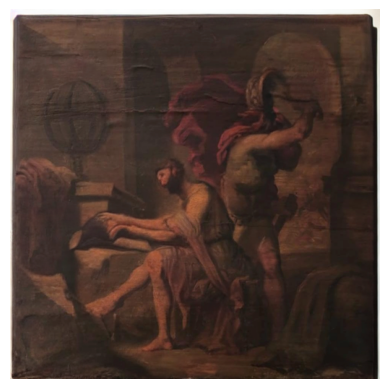

In [ ]:
import cv2
import numpy as np

rest_np = np.array(restored)
orig_np = np.array(damaged_pil)
mask_np = np.array(mask_pil) / 255.0

rest_lab = cv2.cvtColor(rest_np, cv2.COLOR_RGB2LAB)
orig_lab = cv2.cvtColor(orig_np, cv2.COLOR_RGB2LAB)

for i in range(3):
    rest_lab[..., i] = rest_lab[..., i] * mask_np + orig_lab[..., i] * (1-mask_np)

final = cv2.cvtColor(rest_lab, cv2.COLOR_LAB2RGB)
final_pil = Image.fromarray(final.astype(np.uint8))

plt.imshow(final_pil)
plt.axis("off")


In [ ]:
import torch
from diffusers import StableDiffusionInpaintPipeline

DEVICE = "cuda"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

print("Base model loaded clean")


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


Base model loaded clean


In [ ]:
from peft import LoraConfig, get_peft_model

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0"
    ],
    lora_dropout=0.05,
    bias="none"
)

pipe.unet = get_peft_model(pipe.unet, lora_config)
pipe.unet.print_trainable_parameters()


trainable params: 3,188,736 || all params: 862,724,100 || trainable%: 0.3696


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
No LoRA keys associated to UNet2DConditionModel found with the pre

trainable params: 3,188,736 || all params: 862,724,100 || trainable%: 0.3696
✅ Base inpainting + REAL ART LoRA ready for inference
Testing on: 084.png


  0%|          | 0/52 [00:00<?, ?it/s]

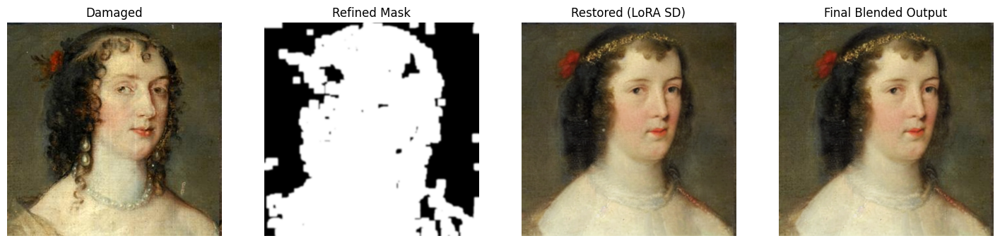

In [ ]:
import os, random, cv2, torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from diffusers import StableDiffusionInpaintPipeline
from peft import LoraConfig, get_peft_model

DEVICE = "cuda"

BASE_MODEL = "runwayml/stable-diffusion-inpainting"
LORA_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_V3_FINAL"

DAMAGED_DIR = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/train/damaged"
MASK_DIR    = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/train/mask"

# -------------------------
# 1) Load clean base model
# -------------------------
pipe = StableDiffusionInpaintPipeline.from_pretrained(
    BASE_MODEL,
    torch_dtype=torch.float16
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False

# ------------------------------------
# 2) Attach SAME LoRA config as train
# ------------------------------------
lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=["to_q", "to_k", "to_v", "to_out.0"],
    lora_dropout=0.05,
    bias="none"
)

pipe.unet = get_peft_model(pipe.unet, lora_config)
pipe.unet.print_trainable_parameters()  # just to sanity-check

# ------------------------------
# 3) Load trained LoRA weights
# ------------------------------
pipe.load_lora_weights(
    LORA_PATH,
    weight_name="adapter_model.safetensors"
)

pipe.unet.eval()
pipe.vae.eval()
pipe.text_encoder.eval()

pipe.enable_attention_slicing()  # lighter on VRAM

print("✅ Base inpainting + REAL ART LoRA ready for inference")

# ------------------------------
# 4) Pick a test painting
# ------------------------------
test_fname = random.choice(os.listdir(DAMAGED_DIR))
print("Testing on:", test_fname)

damaged_pil = Image.open(
    os.path.join(DAMAGED_DIR, test_fname)
).convert("RGB").resize((512, 512))

mask_pil = Image.open(
    os.path.join(MASK_DIR, test_fname)
).convert("L").resize((512, 512))

# -----------------------------------------
# 5) Refine mask (stronger + softer edges)
# -----------------------------------------
mask_np = np.array(mask_pil)

# binarise harder, then dilate, then blur = clean but smooth mask
_, mask_bin = cv2.threshold(mask_np, 140, 255, cv2.THRESH_BINARY)
kernel = np.ones((7, 7), np.uint8)
mask_dilated = cv2.dilate(mask_bin, kernel, iterations=2)
mask_soft = cv2.GaussianBlur(mask_dilated, (9, 9), 0)

mask_pil = Image.fromarray(mask_soft)

# ------------------------------
# 6) Realistic restoration call
# ------------------------------
PROMPT = (
    "museum-quality restoration of an old oil painting, "
    "faithful to the original composition and lighting, "
    "natural brush strokes, realistic skin tones, "
    "no change in pose or objects, only repair cracks and missing paint"
)

NEGATIVE = (
    "cartoon, anime, 3d render, plastic skin, glowing edges, "
    "changed composition, extra objects, oversharpen, halo, artifacts"
)

with torch.no_grad():
    out = pipe(
        prompt=PROMPT,
        negative_prompt=NEGATIVE,
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=80,   # more steps = more detail
        guidance_scale=4.5,       # lower = less 'AI rewrite', more faithfulness
        strength=0.65             # 0.55–0.7 range is usually good
    )

restored_sd = out.images[0]

# -----------------------------------------
# 7) Blend SD result with original outside
#    the mask (keeps canvas & lighting)
# -----------------------------------------
orig = np.array(damaged_pil)
rest = np.array(restored_sd)
m = np.array(mask_pil).astype(np.float32) / 255.0  # [0,1]

final = (rest * m[..., None] + orig * (1 - m[..., None])).astype(np.uint8)
final_pil = Image.fromarray(final)

# ------------------------------
# 8) Visualise comparison
# ------------------------------
plt.figure(figsize=(18, 4))

plt.subplot(1, 4, 1)
plt.title("Damaged")
plt.imshow(damaged_pil)
plt.axis("off")

plt.subplot(1, 4, 2)
plt.title("Refined Mask")
plt.imshow(mask_pil, cmap="gray")
plt.axis("off")

plt.subplot(1, 4, 3)
plt.title("Restored (LoRA SD)")
plt.imshow(restored_sd)
plt.axis("off")

plt.subplot(1, 4, 4)
plt.title("Final Blended Output")
plt.imshow(final_pil)
plt.axis("off")

plt.show()


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
No LoRA keys associated to UNet2DConditionModel found with the pre

Testing file: 084.png


  0%|          | 0/47 [00:00<?, ?it/s]

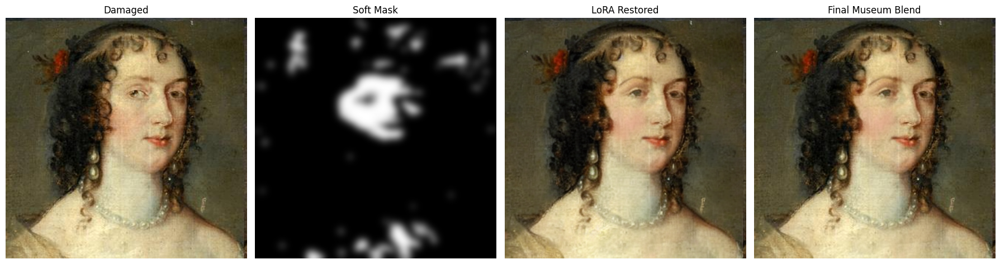

In [ ]:
# ============================================
# FULL INFERENCE PIPELINE (ONE CELL)
# Damaged -> Auto Mask -> LoRA SD -> Museum Blend
# ============================================

import os, random, cv2, torch
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from diffusers import StableDiffusionInpaintPipeline

# ---------- 1. PATHS (EDIT THESE) ----------
BASE = "/content/drive/MyDrive/photo-restoration-lora-vishrutha"
DAMAGED_DIR = f"{BASE}/data/art_damaged"          # or art_damaged, etc.
LORA_PATH   = f"{BASE}/lora_V3_FINAL"         # or lora_output, etc.

# ---------- 2. PIPELINE SETUP ----------
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
dtype  = torch.float16 if DEVICE == "cuda" else torch.float32

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=dtype
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False
pipe.enable_attention_slicing()

# Load your LoRA
pipe.load_lora_weights(
    LORA_PATH,
    weight_name="adapter_model.safetensors"
)

# # ---------- 3. PICK A RANDOM DAMAGED IMAGE ----------
# test_fname = random.choice(os.listdir(DAMAGED_DIR))
# damaged_path = os.path.join(DAMAGED_DIR, test_fname)

# damaged_pil_full = Image.open(damaged_path).convert("RGB")
# damaged_pil = damaged_pil_full.resize((512, 512))

# print("Testing file:", test_fname)

# ---------- 3. FORCE IMAGE 084 ----------
test_fname = "084.png"   # change to 084.jpg if needed
damaged_path = os.path.join(DAMAGED_DIR, test_fname)

if not os.path.exists(damaged_path):
    raise FileNotFoundError(f"Image not found: {damaged_path}")

damaged_pil_full = Image.open(damaged_path).convert("RGB")
damaged_pil = damaged_pil_full.resize((512, 512))

print("Testing file:", test_fname)


# ---------- STEP 4: TRUE DAMAGE-ONLY MASK (NO FACE REPLACEMENT) ----------
dam_np = np.array(damaged_pil)

# A) Convert to LAB for better crack & paint-loss detection
lab = cv2.cvtColor(dam_np, cv2.COLOR_RGB2LAB)
l, a, b = cv2.split(lab)

# B) Detect fine cracks using Laplacian
edges = cv2.Laplacian(l, cv2.CV_8U, ksize=3)

# C) Detect bright paint loss / flakes
_, bright = cv2.threshold(l, 215, 255, cv2.THRESH_BINARY)

# D) Combine crack + flake maps
damage_mask = cv2.bitwise_or(edges, bright)

# E) Clean noise
damage_mask = cv2.medianBlur(damage_mask, 5)

# F) Strengthen thin cracks
kernel = np.ones((5,5), np.uint8)
damage_mask = cv2.dilate(damage_mask, kernel, iterations=1)
damage_mask = cv2.morphologyEx(damage_mask, cv2.MORPH_CLOSE, kernel, iterations=2)

# G) Remove large regions (prevents face/body being replaced)
num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(damage_mask, connectivity=8)

filtered = np.zeros(damage_mask.shape, dtype=np.uint8)
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    if area < 2000:
        filtered[labels == i] = 255

# H) Soft museum-quality edges
mask_soft = cv2.GaussianBlur(filtered, (41, 41), 0)

mask_pil = Image.fromarray(mask_soft).convert("L")


# soft edges so blending looks natural
mask_soft = cv2.GaussianBlur(mask_bin, (51, 51), 0)

mask_pil = Image.fromarray(mask_soft).convert("L")

# ---------- 5. INPAINT WITH LoRA ----------
prompt = (
    "high quality realistic portrait restoration, natural skin texture, "
    "sharp but not over-smoothed details, no scratches or damage"
)
negative_prompt = (
    "scratches, stains, cracks, blur, distortion, extra limbs, deformed face, plastic skin"
)

with torch.no_grad():
    result = pipe(
        prompt=prompt,
        negative_prompt=negative_prompt,
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=50,
        guidance_scale=7.0,
        strength=0.95,
    )

restored_pil = result.images[0]

# ---------- 6. FINAL MUSEUM BLEND ----------
rest_np  = np.array(restored_pil).astype(np.float32) / 255.0
orig_np  = np.array(damaged_pil).astype(np.float32) / 255.0
mask_np  = mask_soft.astype(np.float32) / 255.0

# slightly increase mask influence, but keep <= 1
mask_np = np.clip(mask_np * 1.2, 0.0, 1.0)

final_np = rest_np * mask_np[..., None] + orig_np * (1.0 - mask_np[..., None])
final_pil = Image.fromarray((final_np * 255).astype(np.uint8))

# ---------- 7. SHOW RESULT ----------
fig, axs = plt.subplots(1, 4, figsize=(18, 5))

axs[0].set_title("Damaged")
axs[0].imshow(damaged_pil)
axs[0].axis("off")

axs[1].set_title("Soft Mask")
axs[1].imshow(mask_pil, cmap="gray")
axs[1].axis("off")

axs[2].set_title("LoRA Restored")
axs[2].imshow(restored_pil)
axs[2].axis("off")

axs[3].set_title("Final Museum Blend")
axs[3].imshow(final_pil)
axs[3].axis("off")

plt.tight_layout()
plt.show()


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


✅ Base Inpainting Loaded


No LoRA keys associated to UNet2DConditionModel found with the prefix='unet'. This is safe to ignore if LoRA state dict didn't originally have any UNet2DConditionModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new
No LoRA keys associated to CLIPTextModel found with the prefix='text_encoder'. This is safe to ignore if LoRA state dict didn't originally have any CLIPTextModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new


LoRA Loaded
✅ Testing File: 092.png


  0%|          | 0/60 [00:00<?, ?it/s]

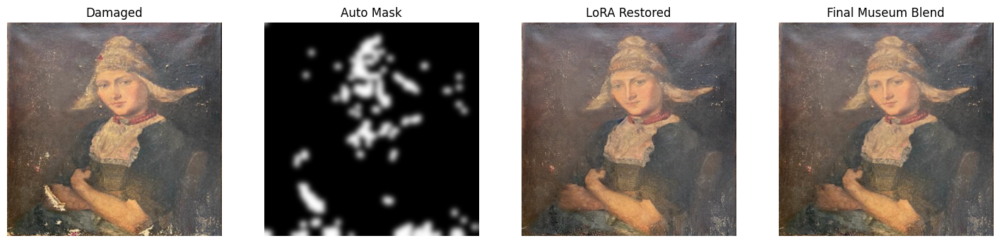

In [ ]:


import torch, os, cv2, numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from diffusers import StableDiffusionInpaintPipeline

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
dtype  = torch.float16 if DEVICE == "cuda" else torch.float32

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=dtype
).to(DEVICE)

pipe.safety_checker = None
pipe.requires_safety_checker = False
pipe.enable_attention_slicing()

print("Base Inpainting Loaded")

LORA_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/lora_V3_FINAL"

pipe.load_lora_weights(
    LORA_PATH,
    weight_name="adapter_model.safetensors",
    prefix=None
)

print("LoRA Loaded")

DAMAGED_DIR = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/art_damaged"

test_fname = "092.png"
damaged_path = os.path.join(DAMAGED_DIR, test_fname)

damaged_pil_full = Image.open(damaged_path).convert("RGB")
damaged_pil = damaged_pil_full.resize((512,512))

print("Testing File:", test_fname)


dam_np = np.array(damaged_pil)
gray = cv2.cvtColor(dam_np, cv2.COLOR_RGB2GRAY)

_, mask_bin = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY)

kernel = np.ones((7,7), np.uint8)
mask_bin = cv2.morphologyEx(mask_bin, cv2.MORPH_CLOSE, kernel)
mask_bin = cv2.dilate(mask_bin, kernel, iterations=2)

mask_soft = cv2.GaussianBlur(mask_bin, (41,41), 0)
mask_pil = Image.fromarray(mask_soft).convert("L")


with torch.no_grad():
    restored = pipe(
        prompt="museum quality painting restoration, realistic preserved face, natural skin texture",
        negative_prompt="blur, damage, scratches, stains, distortion, watermark",
        image=damaged_pil,
        mask_image=mask_pil,
        num_inference_steps=60,
        guidance_scale=9.0,
        strength=1.0
    ).images[0]


rest_np = np.array(restored).astype(np.float32)
orig_np = np.array(damaged_pil).astype(np.float32)
mask_np = np.array(mask_pil).astype(np.float32) / 255.0

final = rest_np * mask_np[..., None] + orig_np * (1 - mask_np[..., None])
final = np.clip(final, 0, 255).astype(np.uint8)

final_pil = Image.fromarray(final)

plt.figure(figsize=(18,5))

plt.subplot(1,4,1)
plt.title("Damaged")
plt.imshow(damaged_pil)
plt.axis("off")

plt.subplot(1,4,2)
plt.title("Auto Mask")
plt.imshow(mask_pil, cmap="gray")
plt.axis("off")

plt.subplot(1,4,3)
plt.title("LoRA Restored")
plt.imshow(restored)
plt.axis("off")

plt.subplot(1,4,4)
plt.title("Final Museum Blend")
plt.imshow(final_pil)
plt.axis("off")

plt.show()


In [ ]:
!pip install -q scikit-image lpips


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 3.3 MB/s eta 0:00:00


In [ ]:
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
import numpy as np

def compute_metrics(gt_img, restored_img):
    """
    gt_img, restored_img: PIL Images (RGB, 0–255)
    """
    gt = np.array(gt_img).astype(np.float32)
    pred = np.array(restored_img).astype(np.float32)

    psnr_val = psnr(gt, pred, data_range=255)

    ssim_val = ssim(
        gt, pred,
        data_range=255,
        channel_axis=2
    )

    return psnr_val, ssim_val

In [ ]:
# RE-ATTACHING DATASET FOR EVALUATION

import os
from PIL import Image
import torch
from torch.utils.data import Dataset
import torchvision.transforms as T

BASE_PATH = "/content/drive/MyDrive/photo-restoration-lora-vishrutha/data/train"
CLEAN_DIR   = os.path.join(BASE_PATH, "clean")
DAMAGED_DIR = os.path.join(BASE_PATH, "damaged")
MASK_DIR    = os.path.join(BASE_PATH, "mask")

img_tf = T.Compose([
    T.Resize((512,512)),
    T.ToTensor(),
])

mask_tf = T.Compose([
    T.Resize((512,512)),
    T.ToTensor(),
])

class EvalDataset(Dataset):
    def __init__(self):
        self.files = sorted(
            list(set(os.listdir(CLEAN_DIR)) &
                 set(os.listdir(DAMAGED_DIR)) &
                 set(os.listdir(MASK_DIR)))
        )

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        fname = self.files[idx]

        clean   = Image.open(os.path.join(CLEAN_DIR, fname)).convert("RGB")
        damaged = Image.open(os.path.join(DAMAGED_DIR, fname)).convert("RGB")
        mask    = Image.open(os.path.join(MASK_DIR, fname)).convert("L")

        return {
            "clean":   img_tf(clean),
            "damaged": img_tf(damaged),
            "mask":    mask_tf(mask)
        }


dataset = EvalDataset()

print("Evaluation Dataset Restored:", len(dataset))

Evaluation Dataset Restored: 109


In [ ]:
import random
from tqdm import tqdm

NUM_SAMPLES = 50

psnr_damaged_list = []
ssim_damaged_list = []

psnr_restored_list = []
ssim_restored_list = []

pipe.unet.eval()
pipe.vae.eval()
pipe.text_encoder.eval()

for i in tqdm(range(NUM_SAMPLES)):

    idx = random.randint(0, len(dataset)-1)
    sample = dataset[idx]

    clean   = sample["clean"]
    damaged = sample["damaged"]
    mask    = sample["mask"]

    # Convert to PIL
    def tensor_to_pil(t):
        t = (t.clamp(-1,1) + 1) / 2
        t = t.squeeze().permute(1,2,0).cpu().float().numpy()
        t = (t * 255).astype(np.uint8)
        return Image.fromarray(t)

    clean_pil   = tensor_to_pil(clean)
    damaged_pil = tensor_to_pil(damaged)

    mask_pil = mask.squeeze().cpu().numpy()
    mask_pil = (mask_pil * 255).astype(np.uint8)
    mask_pil = Image.fromarray(mask_pil).convert("L")

    # Run LoRA Inpainting
    with torch.no_grad():
        restored = pipe(
            prompt="photorealistic face restoration, clean skin, no scratches",
            negative_prompt="scratches, streaks, artifacts",
            image=damaged_pil,
            mask_image=mask_pil,
            num_inference_steps=50,
            guidance_scale=10.0
        ).images[0]

    # --- METRICS ---
    p_d, s_d = compute_metrics(clean_pil, damaged_pil)
    p_r, s_r = compute_metrics(clean_pil, restored)

    psnr_damaged_list.append(p_d)
    ssim_damaged_list.append(s_d)

    psnr_restored_list.append(p_r)
    ssim_restored_list.append(s_r)

# --- FINAL RESULTS ---
print("\nFINAL EVALUATION RESULTS (LoRA Inpainting)\n")

print(f"Damaged → Clean  | PSNR:  {np.mean(psnr_damaged_list):.2f}  | SSIM: {np.mean(ssim_damaged_list):.4f}")
print(f"Restored → Clean | PSNR:  {np.mean(psnr_restored_list):.2f}  | SSIM: {np.mean(ssim_restored_list):.4f}")

print("\nImprovement:")
print(f"PSNR Gain  : {np.mean(psnr_restored_list) - np.mean(psnr_damaged_list):.2f} dB")
print(f"SSIM Gain  : {np.mean(ssim_restored_list) - np.mean(ssim_damaged_list):.4f}")

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  2%|▏         | 1/50 [00:12<10:14, 12.55s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

  4%|▍         | 2/50 [00:24<09:58, 12.47s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

  6%|▌         | 3/50 [00:36<09:24, 12.00s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

  8%|▊         | 4/50 [00:47<08:56, 11.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 10%|█         | 5/50 [00:58<08:37, 11.49s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 12%|█▏        | 6/50 [01:09<08:20, 11.37s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 14%|█▍        | 7/50 [01:21<08:05, 11.30s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 16%|█▌        | 8/50 [01:32<07:55, 11.31s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 18%|█▊        | 9/50 [01:43<07:45, 11.35s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 20%|██        | 10/50 [01:55<07:34, 11.36s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 22%|██▏       | 11/50 [02:06<07:22, 11.36s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 24%|██▍       | 12/50 [02:17<07:10, 11.34s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 26%|██▌       | 13/50 [02:29<06:59, 11.35s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 28%|██▊       | 14/50 [02:40<06:47, 11.32s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 30%|███       | 15/50 [02:51<06:35, 11.30s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 32%|███▏      | 16/50 [03:02<06:23, 11.28s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 34%|███▍      | 17/50 [03:14<06:12, 11.28s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 36%|███▌      | 18/50 [03:25<06:01, 11.29s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 38%|███▊      | 19/50 [03:36<05:50, 11.31s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 40%|████      | 20/50 [03:48<05:39, 11.33s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 42%|████▏     | 21/50 [03:59<05:28, 11.32s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 44%|████▍     | 22/50 [04:10<05:16, 11.32s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 46%|████▌     | 23/50 [04:22<05:05, 11.31s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 48%|████▊     | 24/50 [04:33<04:53, 11.29s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 50%|█████     | 25/50 [04:44<04:42, 11.28s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 52%|█████▏    | 26/50 [04:55<04:30, 11.28s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 54%|█████▍    | 27/50 [05:07<04:19, 11.28s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 56%|█████▌    | 28/50 [05:18<04:07, 11.27s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 58%|█████▊    | 29/50 [05:29<03:56, 11.25s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 60%|██████    | 30/50 [05:40<03:45, 11.25s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 62%|██████▏   | 31/50 [05:52<03:33, 11.26s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 64%|██████▍   | 32/50 [06:03<03:22, 11.28s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 66%|██████▌   | 33/50 [06:14<03:12, 11.31s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 68%|██████▊   | 34/50 [06:26<03:00, 11.30s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 70%|███████   | 35/50 [06:37<02:49, 11.30s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 72%|███████▏  | 36/50 [06:48<02:38, 11.30s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 74%|███████▍  | 37/50 [07:00<02:26, 11.30s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 76%|███████▌  | 38/50 [07:11<02:15, 11.30s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 78%|███████▊  | 39/50 [07:22<02:04, 11.30s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 80%|████████  | 40/50 [07:34<01:52, 11.30s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 82%|████████▏ | 41/50 [07:45<01:41, 11.29s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 84%|████████▍ | 42/50 [07:56<01:30, 11.29s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 86%|████████▌ | 43/50 [08:07<01:19, 11.30s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 88%|████████▊ | 44/50 [08:19<01:08, 11.34s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 90%|█████████ | 45/50 [08:30<00:56, 11.34s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 92%|█████████▏| 46/50 [08:41<00:45, 11.33s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 94%|█████████▍| 47/50 [08:53<00:33, 11.30s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 96%|█████████▌| 48/50 [09:04<00:22, 11.29s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

 98%|█████████▊| 49/50 [09:15<00:11, 11.29s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 50/50 [09:27<00:00, 11.34s/it]


FINAL EVALUATION RESULTS (LoRA Inpainting)

Damaged → Clean  | PSNR:  20.33  | SSIM: 0.6935
Restored → Clean | PSNR:  18.57  | SSIM: 0.6675

Improvement:
PSNR Gain  : -1.76 dB
SSIM Gain  : -0.0259
